# XGBoost to predict discharge disability
### Using all features, with a 5-fold cross validation, using the model trained in notebook 010: a multiclass classification model to give the probability (likelihood) that each patient is in each discharge disability class (mRS 0, 1, 2, 3, 4, 5 or 6)

Examine the consistency of the patterns that the model identifies across 5 k-folds, specifically in terms of feature importance and SHAP.

### Plain English summary

Before look at feature selection, let's look at the performance of a model trained on all of the data, using k-fold splits. Here we will look at the type of SHAP plots available when lokoing at the global picture (all on the data). We will use data from the first kfold.

### Model and data
XGBoost
All the features

### Aims
Look at the global patterns using SHAP for the instances in the first kfold split.

### Observations


#### Further work
How does the probability for the multiclass levels change across the mRS classes? Is it consitently incresing and decreasing up to and away from the predicted class?

#### Resources
Using code from https://github.com/samuel-book/samuel_shap_paper_1/blob/main/xgb_10_features/02b_xgb_combined_fit_accuracy_key_features_separate_k_fold.ipynb

and https://github.com/samuel-book/samuel_shap_paper_1/blob/main/xgb_10_features/03_xgb_combined_shap_key_features.ipynb

(code orignially from 01a_xgb_kfold_all_features_accuracy_importance_shap.ipynb and 01_xgb_5fold_all_features_accuracy_importance_shap.ipynb)

## Import libraries

In [29]:
# Turn warnings off to keep notebook tidy
import warnings
warnings.filterwarnings("ignore")

import os
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import numpy as np
import pandas as pd

import scipy

from xgboost import XGBClassifier
from sklearn.metrics import auc
from sklearn.metrics import roc_curve

import json

from dataclasses import dataclass

import seaborn as sns

from sklearn.metrics import roc_auc_score

from sklearn.metrics import confusion_matrix

import pickle
import shap

from os.path import exists

import math

import importlib
# Import local package
#from utils import waterfall
## Force package to be reloaded
#importlib.reload(waterfall);

# Need for cm subplots?
#from mpl_toolkits.axes_grid1 import make_axes_locatable
#from matplotlib.colors import LogNorm
#from matplotlib.ticker import MultipleLocator

import time

Report the time duration to run notebook

In [30]:
start_time = time.time()

Choose number of kfolds (either =1 for the first kfold, or =5 for the full 5 kfold split)

In [31]:
n_kfold = 5

## Set up paths and filenames

Use os.path.join() to create filenames. So define folders without trailing forward slash, and include all characters in file names.

In [32]:
@dataclass(frozen=True)
class Paths:
    '''Singleton object for storing paths to data and database.'''
    image_save_path: str = './saved_images'
    model_save_path: str = './saved_models'
    data_save_path: str = './saved_data'
    data_read_path: str = '../data_processing/output/kfold_5fold'
    model_text: str = f'xgb_all_features_{n_kfold}fold'
    notebook: str = '013_'

paths = Paths()

Create output folders if needed

In [33]:
path = paths.image_save_path
if not os.path.exists(path):
    os.makedirs(path)
        
path = paths.model_save_path
if not os.path.exists(path):
    os.makedirs(path)

path = paths.data_save_path
if not os.path.exists(path):
    os.makedirs(path)

Some features need to be removed from the dataset (those that are duplicates). Define a function to do this.

In [34]:
def drop_columns(df, cols):
    for col in cols:
        if col in df.columns: df.drop([col],axis=1,inplace=True)
    return(df)

Specify the columns to remove

In [35]:
cols_remove = ['id','stroke_team_id']

## Import data

Data has previously been split into 5 stratified k-fold splits. Read these in.

In [36]:
train_data_kfold, test_data_kfold = [], []

for k in range(n_kfold):
    # Read in training set, restrict to chosen features, rename titles, & store
    filename = os.path.join(paths.data_read_path, 
                            ('03_train_' + str(k) + '.csv'))
    train = pd.read_csv(filename)
#    train.rename(columns=dict_feature_name, inplace=True)
    train = drop_columns(train, cols_remove)
    train_data_kfold.append(train)

    filename = os.path.join(paths.data_read_path, 
                            ('03_test_' + str(k) + '.csv'))
    test = pd.read_csv(filename)
#    test.rename(columns=dict_feature_name, inplace=True)
    test = drop_columns(test, cols_remove)
    test_data_kfold.append(test)

Select the features for the model

In [37]:
selected_features = list(train_data_kfold[0])
selected_features.remove('discharge_disability')
n_features = len(selected_features)
selected_features.append('discharge_disability')

Limit dataset to selected features (in this case, we are keeping all the available features, the previous cell may specify otherwise for another purpose)

In [38]:
for k in range(n_kfold):
    train = train_data_kfold[k]
    train = train[selected_features]
    train_data_kfold[k] = train

    test = test_data_kfold[k]
    test = test[selected_features]
    test_data_kfold[k] = test

Store the output classes

In [39]:
class_names = train_data_kfold[0]['discharge_disability'].unique()
class_names = np.sort(class_names)
n_classes = len(class_names)

Take copy of stroke team to use to create a histogram (before this feature is converted into a one hot encoded feature)

In [40]:
test_stroke_team_kfold = (
                 [test_data_kfold[k]["stroke_team"] for k in range(n_kfold)])

### One hot the categorical features

Convert some categorical features to one hot encoded features.

Define a function

In [41]:
def convert_feature_to_one_hot(df, feature_name, prefix):
    """
    df [dataframe]: training or test dataset
    feature_name [str]: feature to convert to ont hot encoding
    prefix [str]: string to use on new feature
    """

    # One hot encode a feature
    df_feature = pd.get_dummies(
        df[feature_name], prefix = prefix)
    df = pd.concat([df, df_feature], axis=1)
    df.drop(feature_name, axis=1, inplace=True)

    return(df)

Set up two lists for the one hot encoding. 

A list of the feature names that are categorical and to be converted using one hot encoding.
A list of the prefixes to use for these features.

In [42]:
features_to_one_hot = ["stroke_team", "weekday"]
list_prefix = ["team", "weekday"]

For each feature in the list, for each train and test dataset, convert to one hot encoded.

In [43]:
for feature, prefix in zip(features_to_one_hot, list_prefix):
    if feature in selected_features:
        for k in range(n_kfold):
            train_data_kfold[k] = (
                            convert_feature_to_one_hot(train_data_kfold[k], 
                                                       feature, prefix))
            test_data_kfold[k] = (
                            convert_feature_to_one_hot(test_data_kfold[k], 
                                                       feature, prefix))

Feature names with one hot encoding

In [44]:
feature_names_ohe = list(train_data_kfold[0])
feature_names_ohe.remove("discharge_disability")
n_features = len(feature_names_ohe)

In [45]:
print(f"There are {len(selected_features)} original features "
      f"(before one-hot encoding)")
print(f"There are {n_features} features (after one-hot encoding)")

There are 55 original features (before one-hot encoding)
There are 177 features (after one-hot encoding)


## Load XGBoost model

Load the model from notebook 010 that was trained on all features.

Create function to return X and y data for train and test sets

In [46]:
def get_x_y_data(train, test, target):
    """
    Pass data from the split and return the dataframes with the target in one 
    dataframe (X), and dependent features in another (y)
    
    train (dataframe): dataframe containing training instances 
    test (dataframe): dataframe containing test instances
    target (string): column name of the targert feature (the column to separate from the two dataframes)
    """    

    # Get X and y
    X_train = train.drop(target, axis=1)
    X_test = test.drop(target, axis=1)
    y_train = train[target]
    y_test = test[target]

    return(X_train, X_test, y_train, y_test)

Create function to load SHAP values extension X and y data for train and test sets

In [47]:
def load_shap_extended(filename):
    """
    TreeExplainer is a fast and exact method to estimate SHAP values for tree 
    models and ensembles of trees. Using this we can calculate the SHAP values.

    Either load from pickle (if file exists), or calculate.

    model (xgboost object):
    k: kfold number
    X_train: training set (used as background data)
    X_test: test set (to calculate the SHAP values for)

    return the extended shap values (contains .values, .base, and .data)
        
    """
    # Check if exists
    file_exists = exists(filename)

    if file_exists:
        # Load extended SHAP values
        with open(filename, 'rb') as filehandler:
            shap_values_extended = pickle.load(filehandler)
    else:
        # Calculate SHAP values
        print('Run notebook 011 first. SHAP values were calculated there')
        
    return(shap_values_extended)

In [48]:

r_square_kfold = []
roc_auc_ovr_kfold = []
accuracy_kfold = []
error_within_one_kfold = []
feature_importance_kfold = []
y_probs_kfold = []
y_pred_kfold = []
model_kfold = []
shap_values_extended_kfold = []
shap_values_kfold = []

# Loop through k folds
for k in range(n_kfold):

    # Get k fold split
    (X_train, X_test, y_train, y_test) = get_x_y_data(train_data_kfold[k],
                                                      test_data_kfold[k],
                                                      'discharge_disability')

    # Model filename
    filename = os.path.join(paths.model_save_path, 
                            ('010_' + paths.model_text + '_' + str(k) + '.p'))

    # Check if exists
    file_exists = exists(filename)

    if file_exists:
    # Load models
        with open(filename, 'rb') as filehandler:
            model = pickle.load(filehandler)
            model_kfold.append(model)        
    else:
        print('Run notebook 010 first. Using the model that was trained there')
    # Get target categories from model
    
    classes = model.classes_

    # Get and store predicted probabilities
    y_probs = model.predict_proba(X_test)
    y_probs_kfold.append(y_probs)

    # Get and store predicted class
    y_pred = model.predict(X_test)
    y_pred_kfold.append(y_pred)

    # Calculate ROC AUC for multiclass models, using One vs Rest
    roc_auc_ovr = roc_auc_score(y_test, y_probs, labels = classes, 
                                multi_class = 'ovr', average = 'macro')
    roc_auc_ovr_kfold.append(roc_auc_ovr)

    # Calculate error
    y_error = y_test - y_pred
    accuracy = np.mean(y_error==0)
    accuracy_kfold.append(accuracy)

    error_within_one = np.mean(np.abs(y_error)<=1)
    error_within_one_kfold.append(error_within_one)

    # Get and store feature importances
    feature_importance = model.feature_importances_
    feature_importance_kfold.append(feature_importance)


    # Set filename
    filename = os.path.join(paths.data_save_path, 
                            ('011_' + paths.model_text + 
                             '_shap_values_extended_' + str(k) + '.p'))
    # Get and store SHAP values
    shap_values_extended_kfold.append(load_shap_extended(filename))
    shap_values_kfold.append(shap_values_extended_kfold[k].values)

    # Print progress
    print (f'Completed {k+1} of {n_kfold}')

accuracy_mean = np.mean(accuracy_kfold)
error_within_one_mean = np.mean(error_within_one_kfold)

print (f'All features, accuracy: {accuracy_mean:0.3f} '
       f'(std across {n_kfold} kfolds: {np.std(accuracy_kfold):0.3f})')

print (f'All features, accuracy within one: {error_within_one_mean:0.3f} '
       f'(std across {n_kfold} kfolds: {np.std(error_within_one_kfold):0.3f})')

Completed 1 of 5
Completed 2 of 5
Completed 3 of 5
Completed 4 of 5
Completed 5 of 5
All features, accuracy: 0.441 (std across 5 kfolds: 0.002)
All features, accuracy within one: 0.759 (std across 5 kfolds: 0.002)


## Section 1.2: SHAP values
SHAP values give the contribution that each feature has on the models prediction, per instance. A SHAP value is returned for each feature, for each instance, for each of the 7 output classes. We can analyse the SHAP values in a different way than if it was a binary model.

We will use the shap library: https://shap.readthedocs.io/en/latest/index.html

'Raw' SHAP values from XGBoost model are log odds ratios. A SHAP value is returned for each feature, for each instance, for each model (one per k-fold)

# (KP MAKE THIS WROK FROM 230623)
In notebook 011 we looked at th summary SHAP plot for each kfold. This showed on one plot (per kfold) the contribution (in terms of mean absolute SHAP) of a feature to each class output.

Here we will delve a little deeper.

We've looked at the level of contribution each feature has on determining if a patient has a specific disability at discharge. Here we use dependence plots to look at patterns between the features (feature values and SHAP values) for each output class.

Each subplot contains a matrix of these features, showing the relationship between the SHAP value and feature value of one feature, while displaying the feature values of another feature. Each figure contains information for each output class - so we can observe how these patterns change depending on which output class are predicting.

We create a matrix of dependence plots (a plot per feature), and so we need to limit the number of features that we can include so that the visualisation is understandable.

We will include four features (informed by the importance results above): prior disability, age, str severity and onset to thrombolysis time.

This is to show an example of the type of visualisation that we can use to understand patterns that the model has identified. This is for a single kfold.

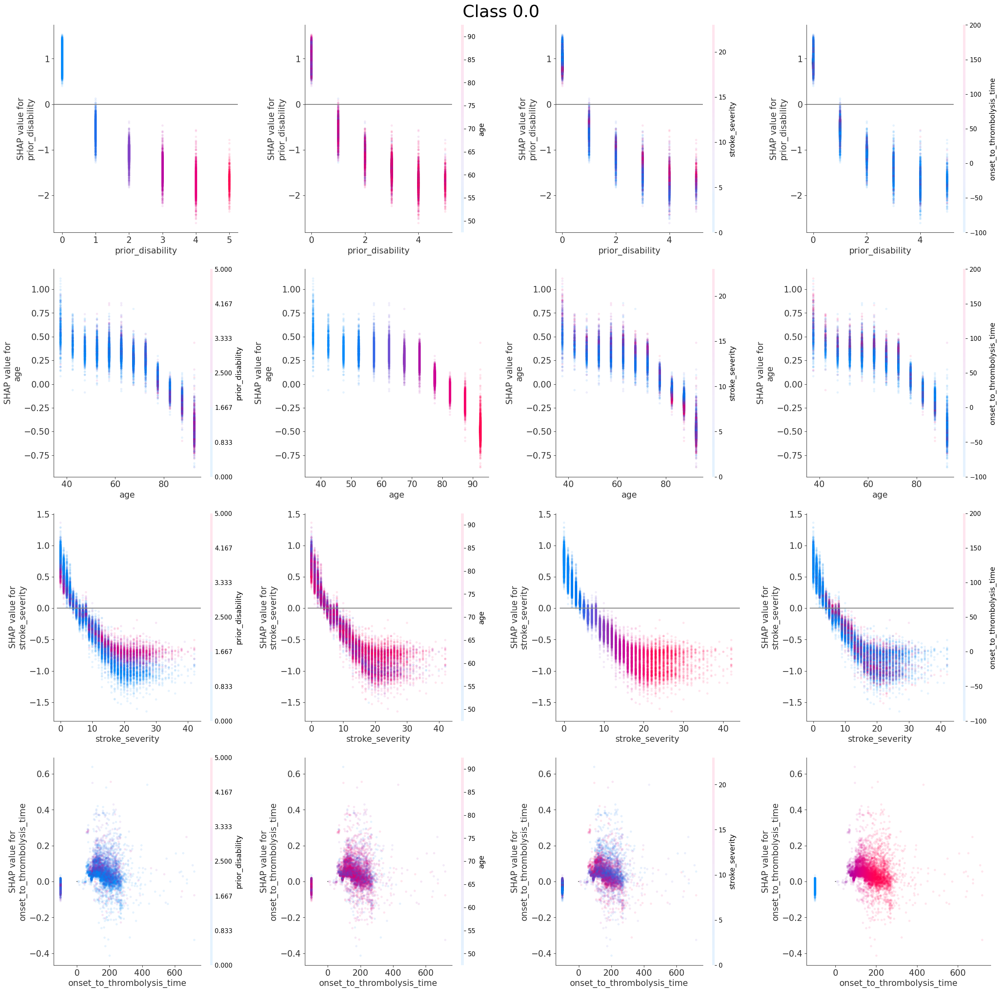

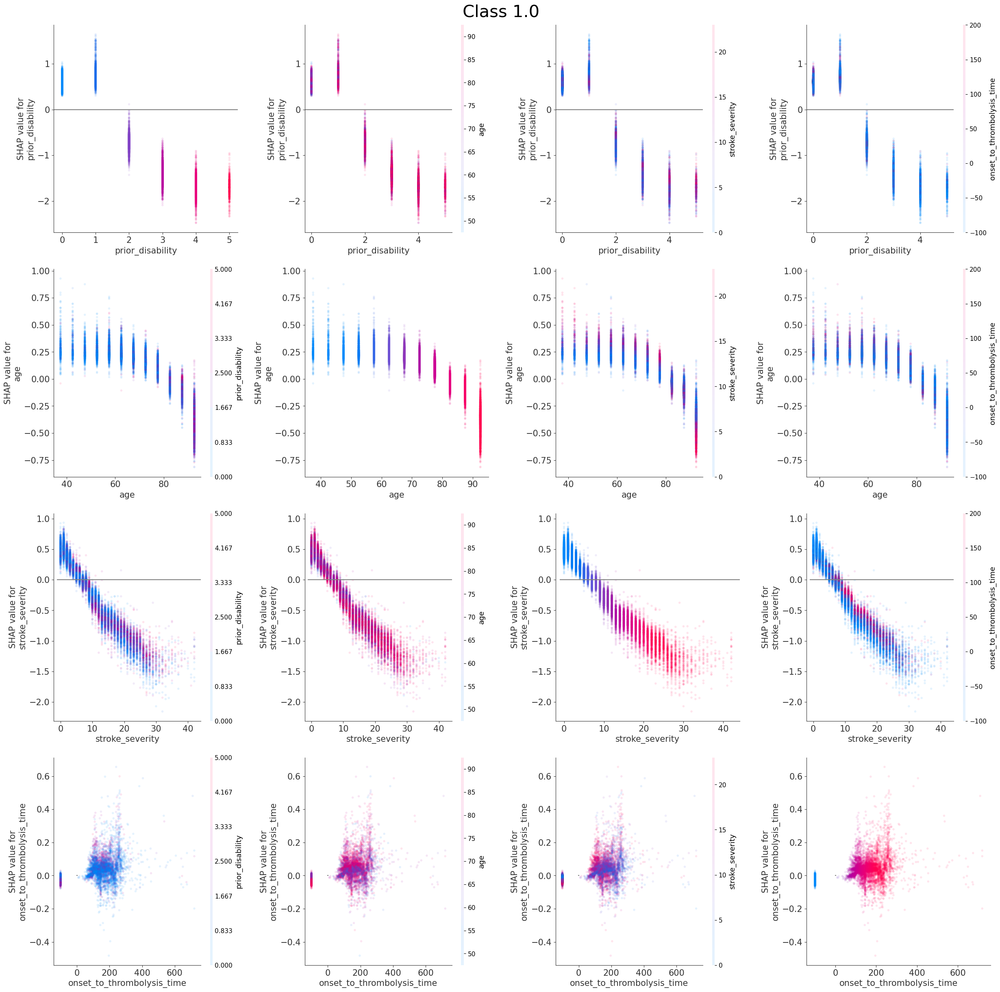

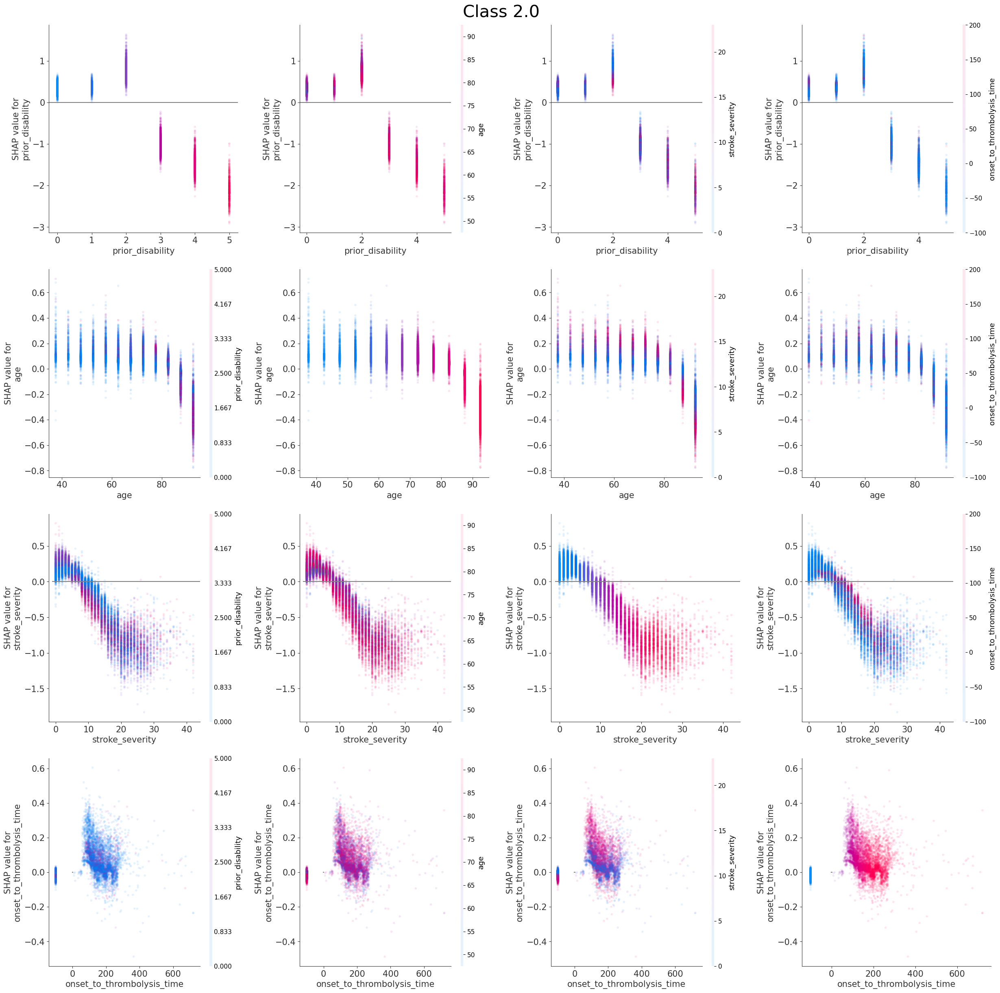

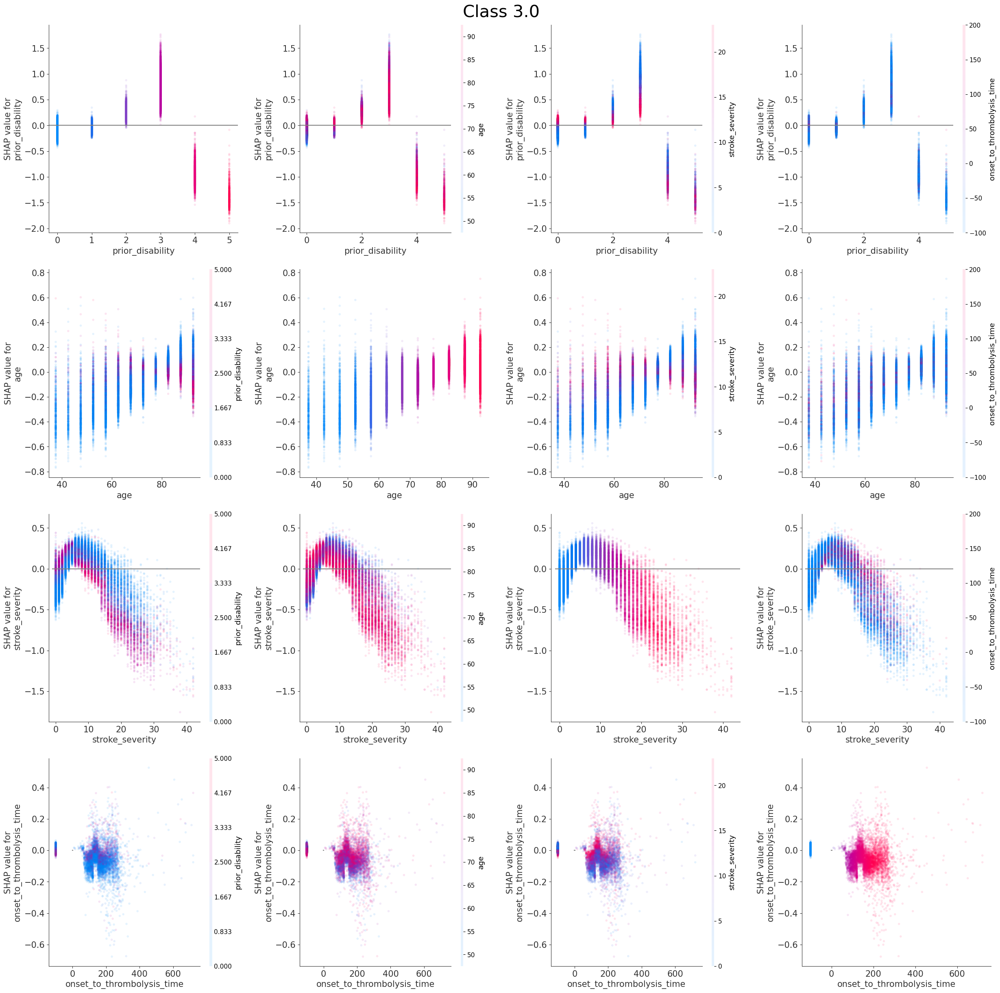

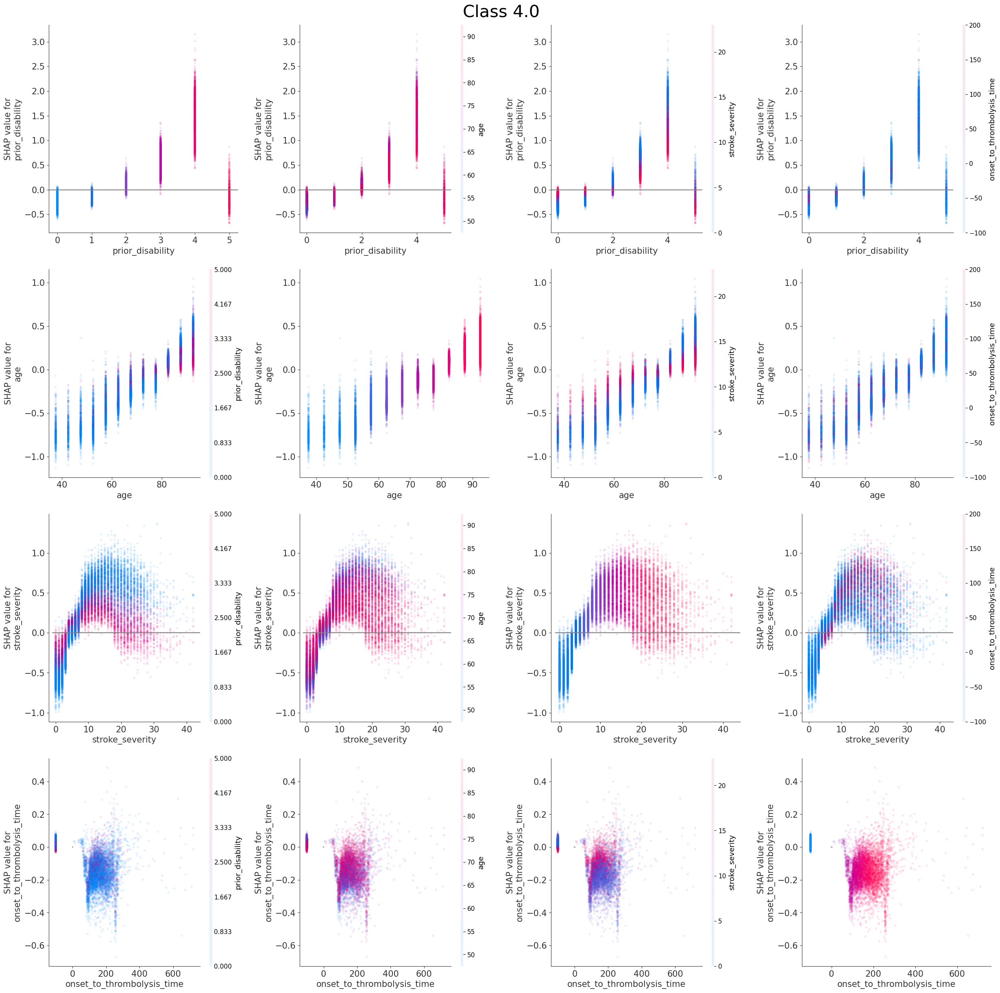

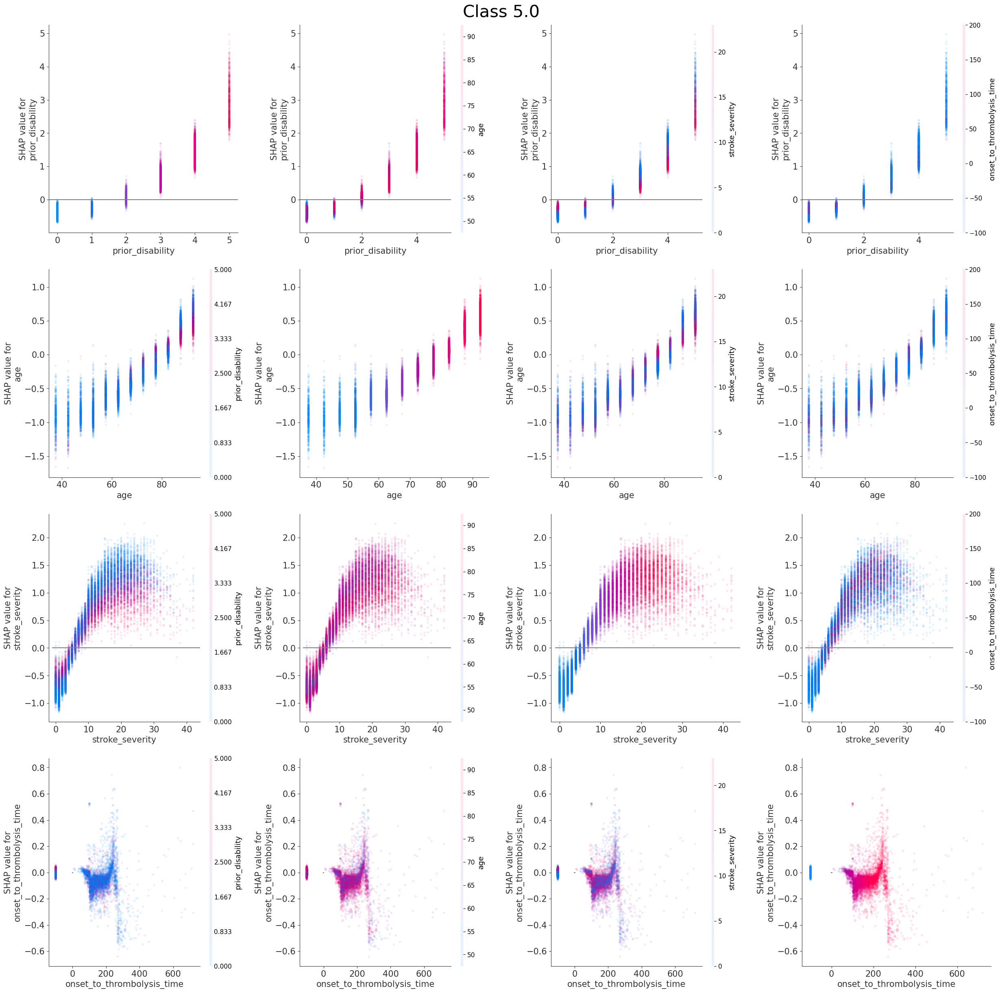

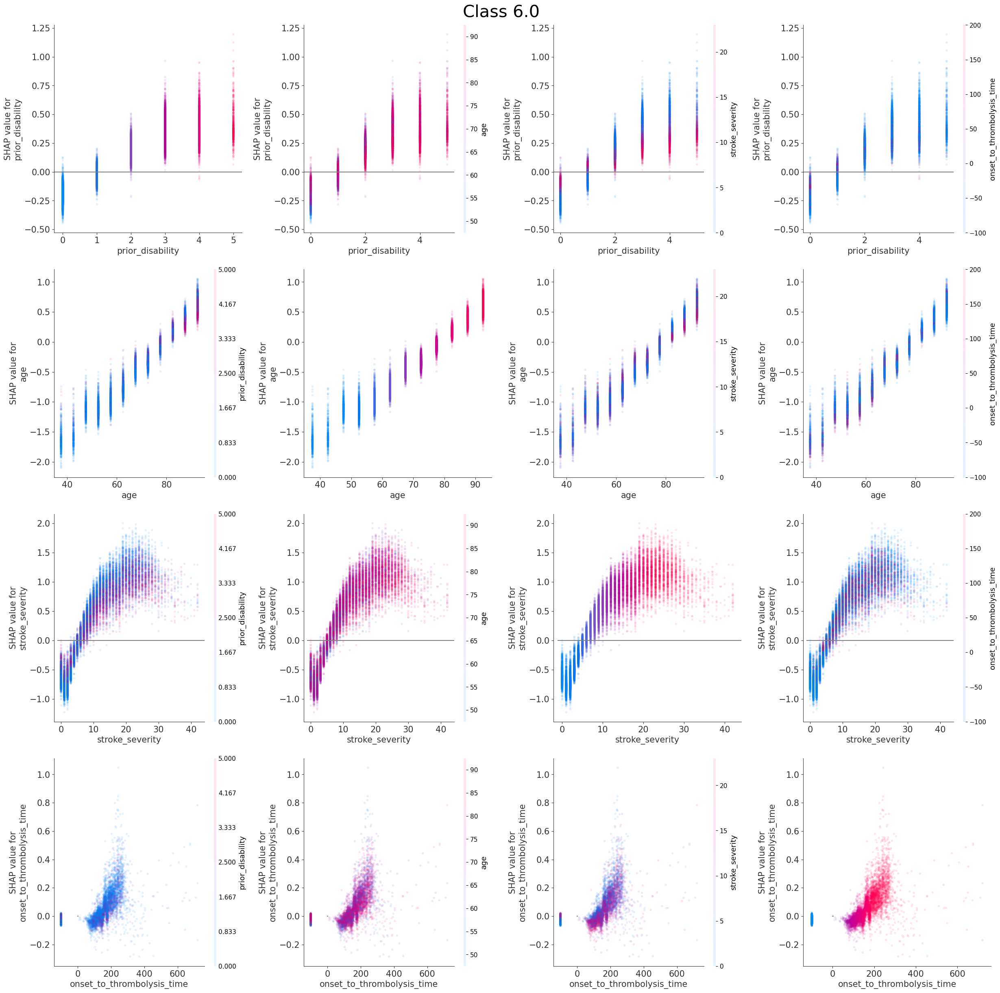

In [49]:
features_to_show = ["prior_disability", "age", "stroke_severity", 
                    "onset_to_thrombolysis_time"]

n_features_show = len(features_to_show)

k = 0

# Get k fold split
(X_train, X_test, y_train, y_test) = get_x_y_data(train_data_kfold[k],
                                                    test_data_kfold[k],
                                                    'discharge_disability')

# Create a matrix of subplots per class. Each showing the relationship between
# each combination of features on the SHAP value.
for c in range(n_classes):

    # setup matrix of subplots
    fig, axes = plt.subplots(nrows=n_features_show,
                             ncols=n_features_show)
    axes = axes.ravel()

    # Set overall title
    fig.suptitle(f'Class {model.classes_[c]}', fontsize=30)

    # Initialise subplot counter
    count = 0

    # Loop through the features to display
    for i in range(len(features_to_show)):
        # Loop through the features to display
        for j in range(len(features_to_show)):
            # Create the plot. Pass the axes
            shap.dependence_plot(ind=features_to_show[i], 
                                interaction_index=features_to_show[j], 
                                shap_values=shap_values_kfold[k][:,:,c], 
                                features=X_test.values, 
                                feature_names=X_test.columns,
                                show=False, ax=axes[count],
                                alpha=0.1)#, dot_size=2)
            # reduce the dot size/transparancy to reveal dense vs sparse areas
            #https://slundberg.github.io/shap/notebooks/plots/dependence_plot.html
            
            # Add line as shap=0
            axes[count].plot([-1, X_test[feature_names_ohe[i]].max()+1],
                             [0,0],c='0.5')
            
            # Increase subplot counter
            count+=1
    
    # Change font size for each subplot
    for ax in axes:
        ax.set_xlabel(ax.get_xlabel(), fontsize=15)
        ax.set_ylabel(ax.get_ylabel(), fontsize=15)
        ax.tick_params(axis='both',which='major',labelsize=15)

    # Visual propoerties of figure
    dimension = 5 * 5
    fig.set_figheight(dimension)
    fig.set_figwidth(dimension)
    fig.tight_layout(pad=2)
    plt.show()

We can also choose one of these feature combinations and focus on seeing how the patterns change across the classes (to do this comparison from the above plots requires a lot of scrolling and memory of the patterns seen in the other classes)

# KP CHECK VALUES ALWAYS MATCH THE LABELS AS WHEN SET ranked_feature = 0, GET AGE LABEL BUT NOT AGE VALUES ON X ASIX

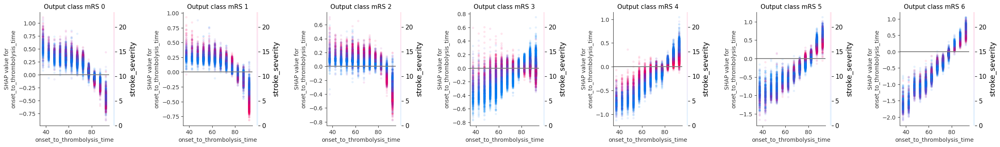

In [50]:
k = 0
ranked_feature = 0

(X_train, X_test, y_train, y_test) = get_x_y_data(train_data_kfold[k],
                                                test_data_kfold[k],
                                                'discharge_disability')
# setup matrix of subplots
fig, axes = plt.subplots(nrows=1, ncols=n_classes, figsize=(25,4))
axes = axes.ravel()

for c in range(n_classes):

    shap_values = shap_values_kfold[k][:,:,c]
    shap.dependence_plot(ranked_feature, shap_values, X_test.values, 
                     feature_names=X_test.columns,
                     show=False, ax=axes[c],alpha=0.1)#, dot_size=2)
            # reduce the dot size/transparancy to reveal dense vs sparse areas
            #https://slundberg.github.io/shap/notebooks/plots/dependence_plot.html
            

    # Change font size for each subplot
    axes[c].set_xlabel(ax.get_xlabel(), fontsize=10)
    axes[c].set_ylabel(ax.get_ylabel(), fontsize=10)
    axes[c].tick_params(axis='both',labelsize=10)
    axes[c].set_title(label=f"Output class mRS {c}", fontsize=11)
    axes[c].set_ylim()
    # Add line as shap=0
    axes[c].plot(axes[c].get_xlim(), [0,0], c='0.5')
    
    

# Visual propoerties of figure
#dimension = 5 * 5
#fig.set_figheight(dimension)
#fig.set_figwidth(dimension)
fig.tight_layout(pad=2)
fig.tight_layout(pad=2)

plt.show()


Can also check pattern across k-folds for a class

# KP CHECK HOW TO GET SAME FEATURES ACROSS THE SUBPLOTS

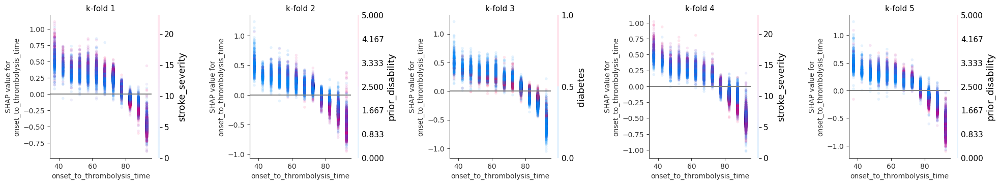

In [51]:
c = 0
ranked_feature = 0

# setup matrix of subplots
fig, axes = plt.subplots(nrows=1, ncols=n_kfold, figsize=(20,4))
axes = axes.ravel()

for k in range(n_kfold):
    (X_train, X_test, y_train, y_test) = get_x_y_data(train_data_kfold[k],
                                                    test_data_kfold[k],
                                                    'discharge_disability')

    shap_values = shap_values_kfold[k][:,:,c]
    shap.dependence_plot(ranked_feature, shap_values, X_test.values, 
                         feature_names=X_test.columns,
                         show=False, ax=axes[k],alpha=0.1)#, dot_size=2)
            # reduce the dot size/transparancy to reveal dense vs sparse areas
            #https://slundberg.github.io/shap/notebooks/plots/dependence_plot.html
            

    # Change font size for each subplot
    axes[k].set_xlabel(ax.get_xlabel(), fontsize=10)
    axes[k].set_ylabel(ax.get_ylabel(), fontsize=10)
    axes[k].tick_params(axis='both',labelsize=10)
    axes[k].set_title(label=f"k-fold {k+1}", fontsize=11)

    # Add line as shap=0
    axes[k].plot(axes[k].get_xlim(), [0,0], c='0.5')
    
    

# Visual propoerties of figure
#dimension = 5 * 5
#fig.set_figheight(dimension)
#fig.set_figwidth(dimension)
fig.tight_layout(pad=2)

plt.show()

Think this shows the first few features in the order they appear, whereas lets specify the features want to be included.

Not sure how much information I take form these plots (To remind what expect, figure has got x axis "Shap interaction", and a bunch of subplots of red and blue dots.)

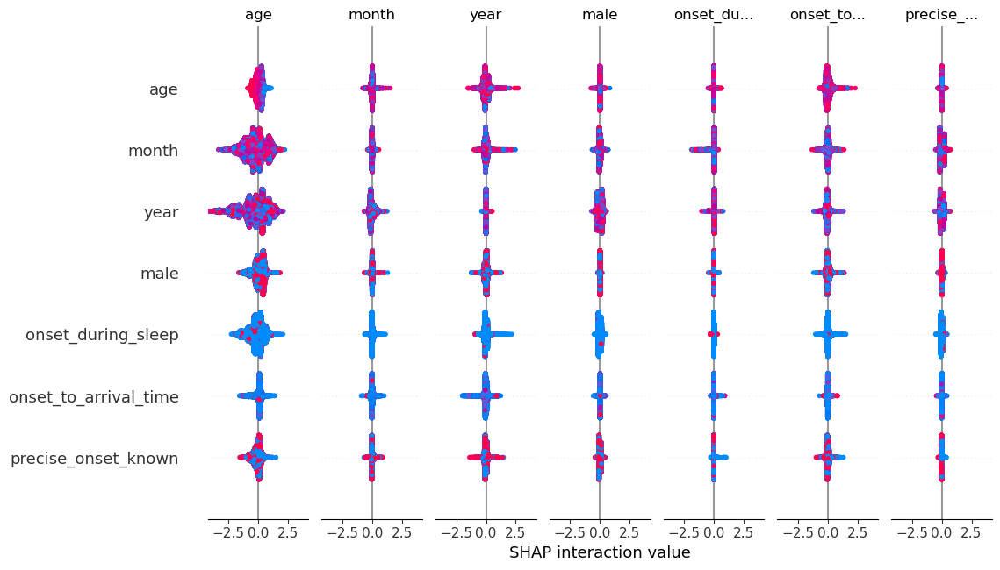

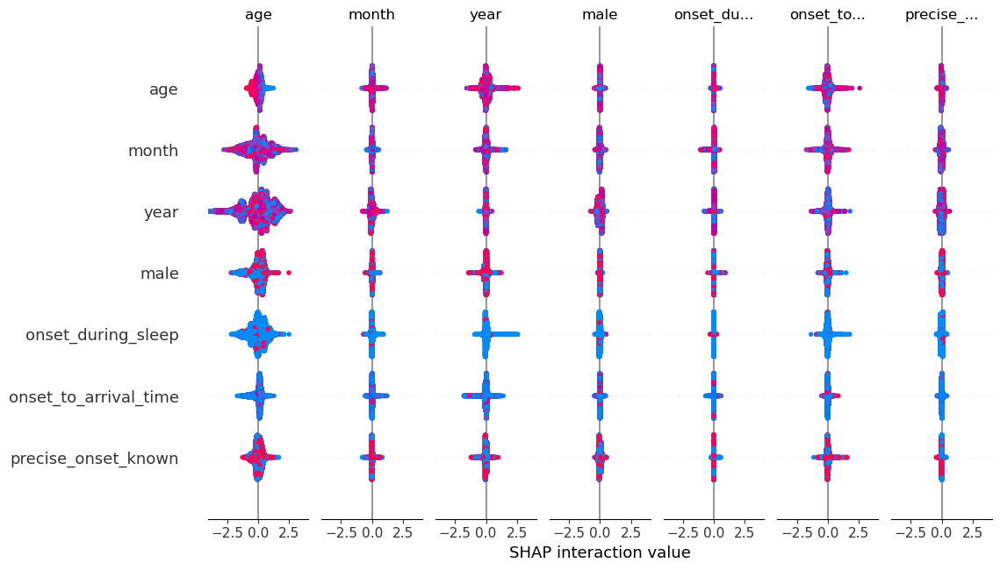

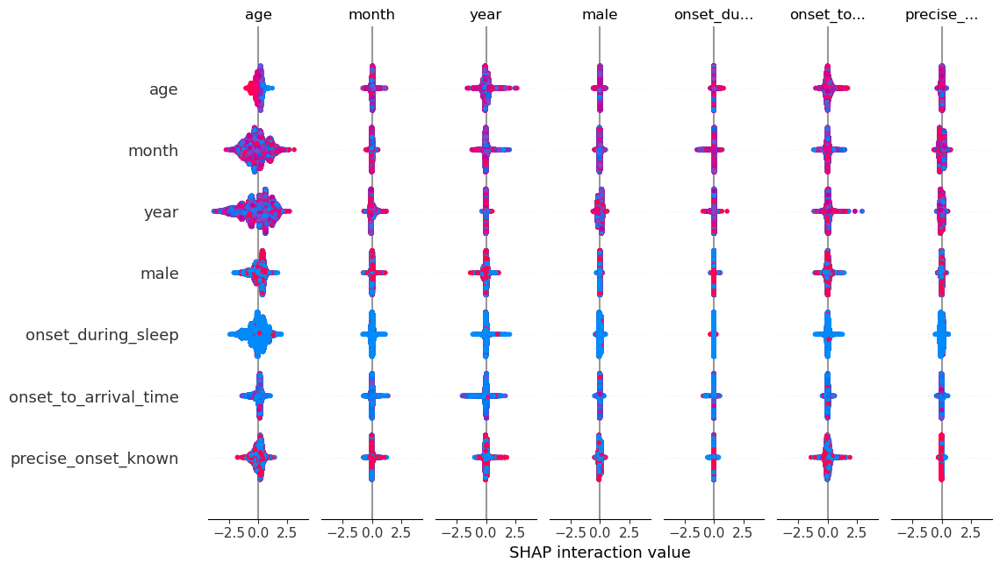

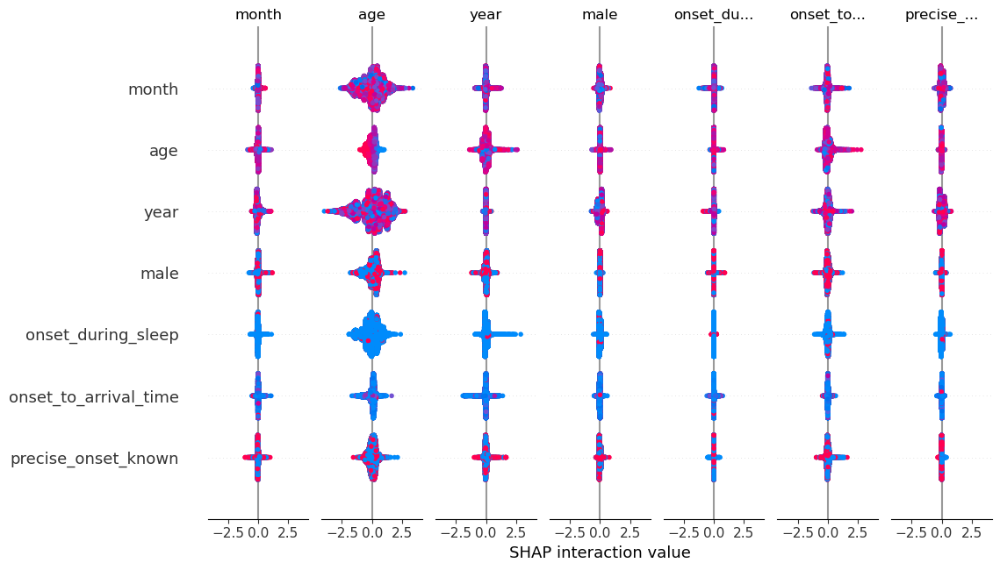

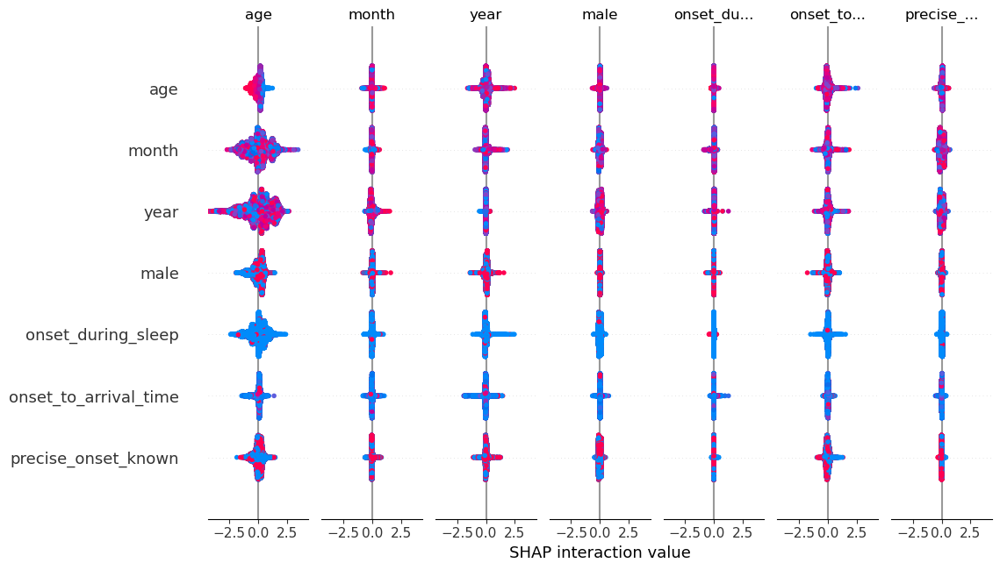

In [52]:
for k in range(n_kfold):
    # Initialise empty list
    shap_values_list = []
    # Putting the SHAP values in the required format
    for c in range(n_classes):
        shap_values_list.append(shap_values_kfold[k][:,:,c])

    # Get k fold split
    (X_train, X_test, y_train, y_test) = get_x_y_data(train_data_kfold[k],
                                                      test_data_kfold[k],
                                                      'discharge_disability')

    # Plot a SHAP summary plot, one for each k-fold
    shap.summary_plot(shap_values_kfold[k], X_test.values, plot_type="bar", 
                  class_names=class_names, feature_names=X_test.columns, 
                  show=False, plot_size=(6,6), title=f"k-fold {k+1}")
    
#    plt.title(f"K-fold {k+1}")
    plt.tight_layout()
    plt.show()  

### View the global case: Beeswarm plot

A Beeswarm plot shows data for all of the test instances. 

The feature value for each point is shown by the colour, and its position indicates the SHAP value for that instance.

Beeswarm plots are used to get a global picture of how the feature value interacts with it's SHAP value.

You can also see the summary_plot of a specific class/kfold.

Reminder: shap_values_kfold[kfold][instance, feature, class]

## TODO?: Try and group together the figures that are the same class across the different kfolds.

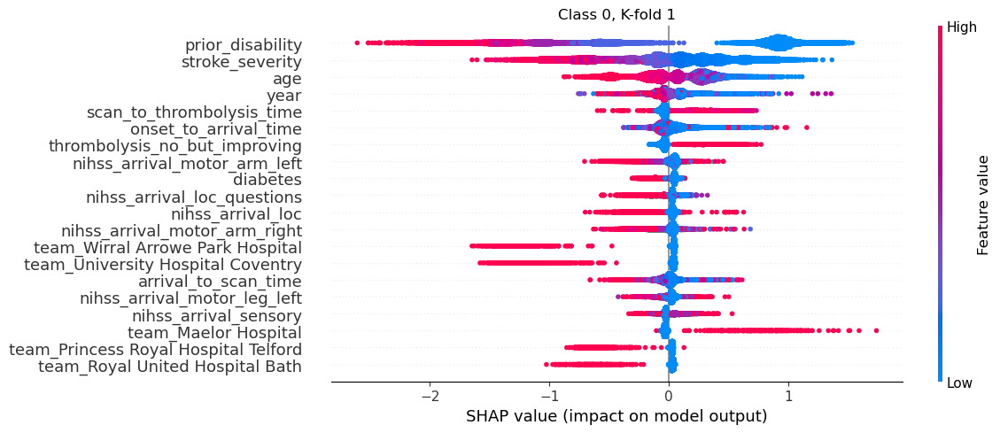

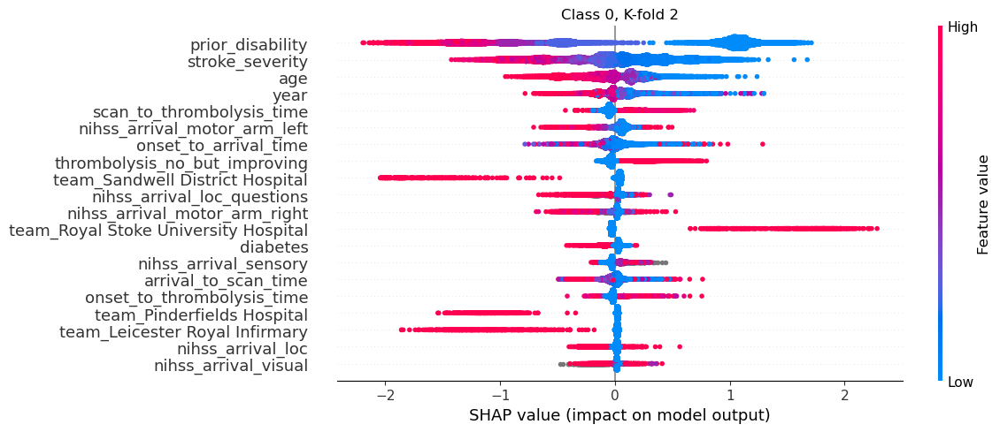

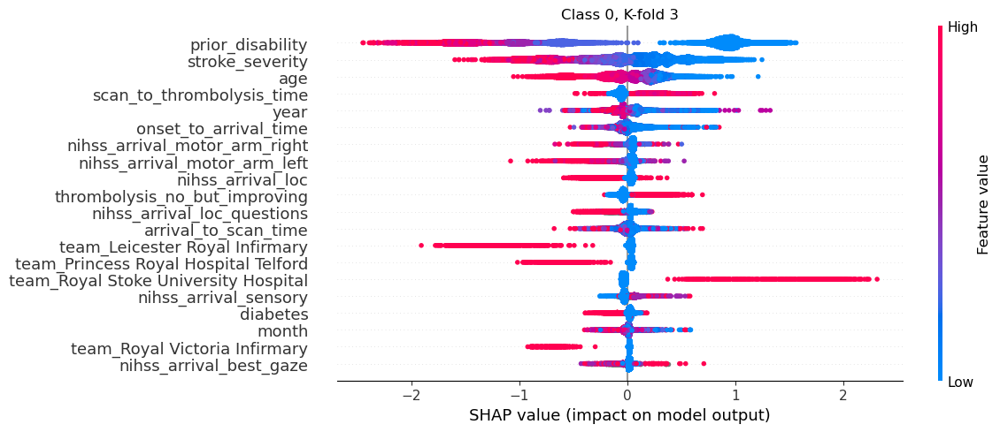

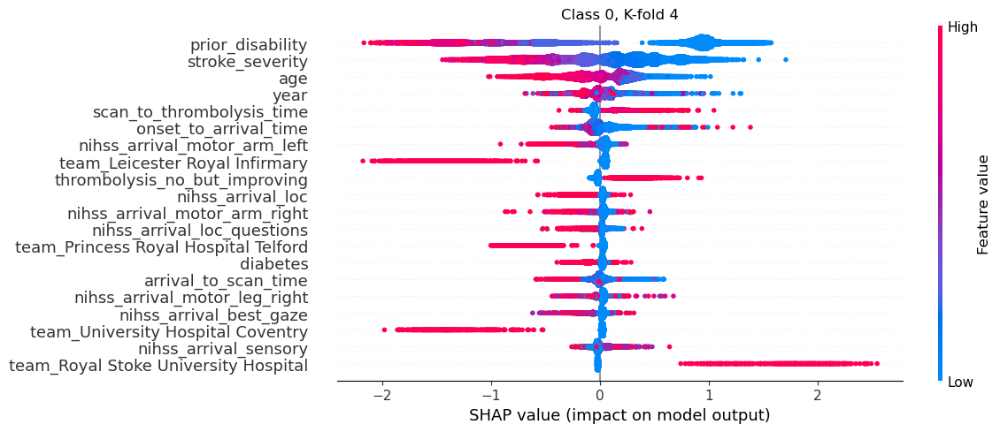

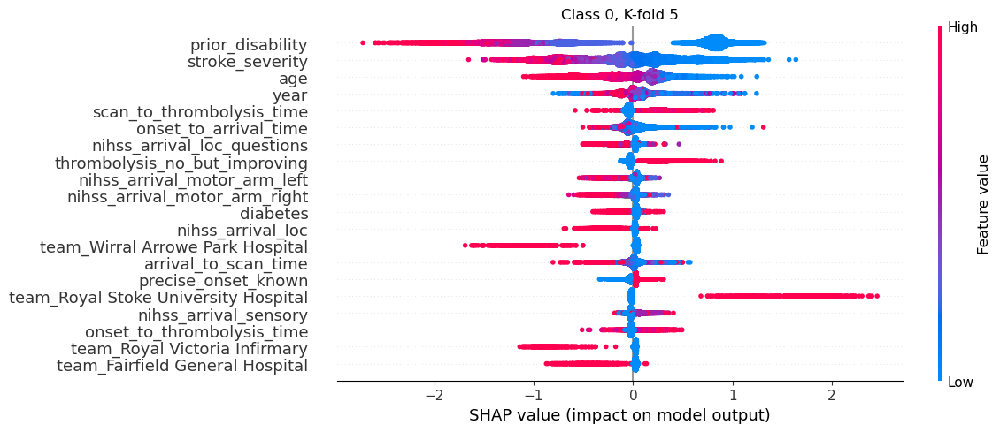

...

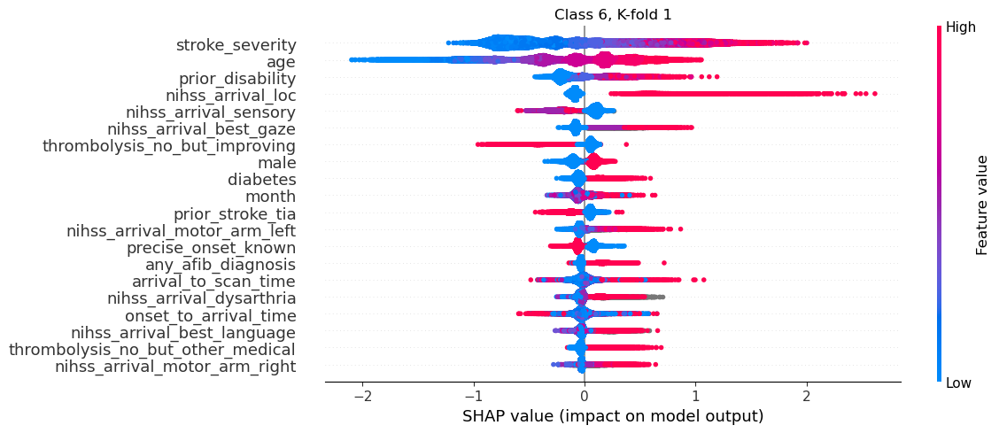

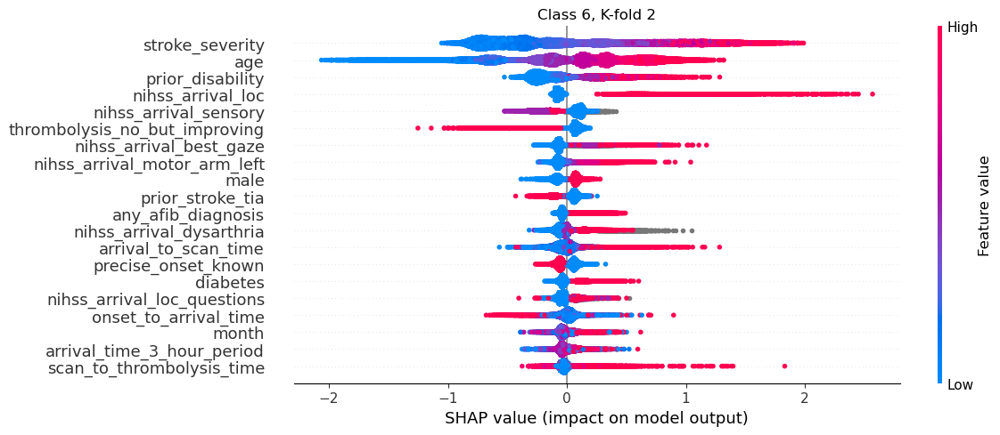

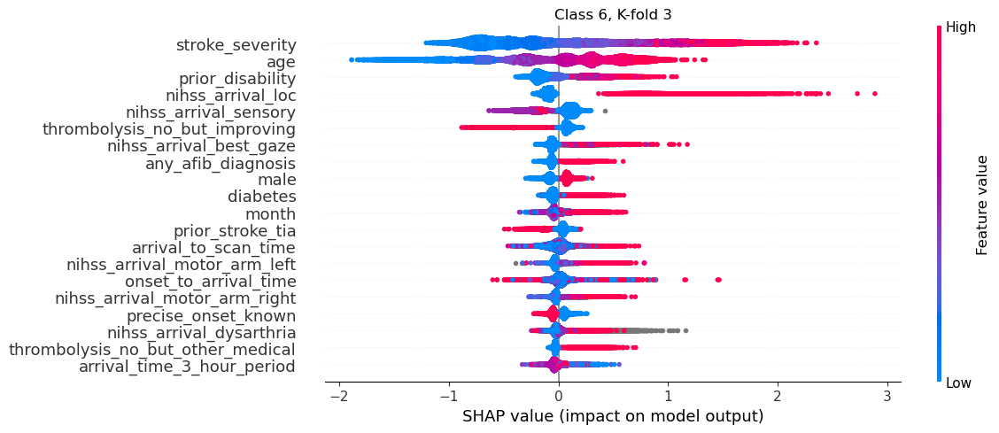

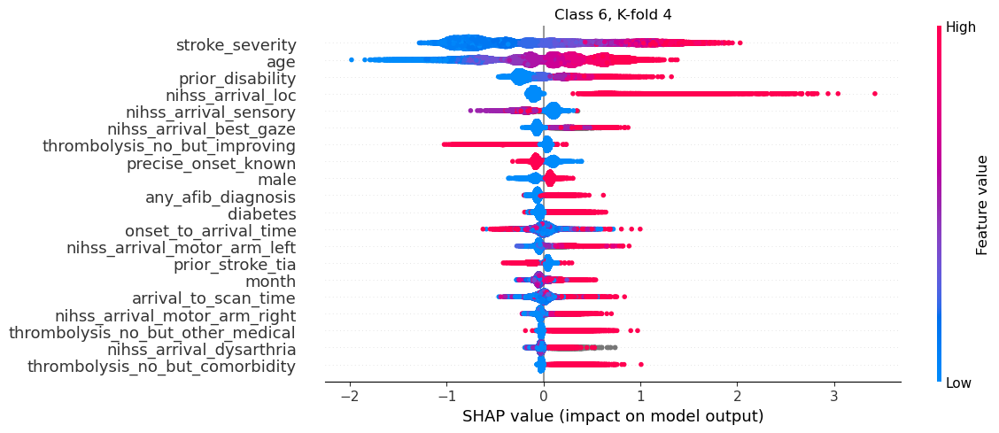

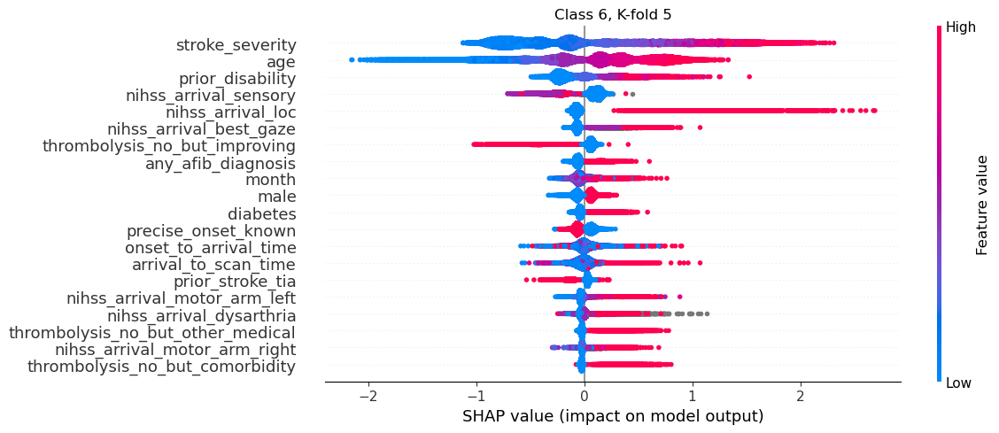

In [53]:
for c in range(len(class_names)):
    for k in range(5):
        # Get k fold split
        (X_train, X_test, y_train, y_test) = get_x_y_data(train_data_kfold[k],
                                                        test_data_kfold[k],
                                                        'discharge_disability')

        shap.summary_plot(shap_values_kfold[k][:,:,c], X_test.values, 
                        feature_names=X_test.columns, show=False, 
                        plot_size=(12,5))

        plt.title(f"Class {c}, K-fold {k+1}")
        plt.tight_layout()
        plt.show()

Violin plots show the relationship between feature value and SHAP value for all of the features Output descriptive text to use in the paper to describe the differences a feature value had on the likelihood of receiving thromboylsis.

Resource: https://towardsdatascience.com/binning-records-on-a-continuous-variable-with-pandas-cut-and-qcut-5d7c8e11d7b0 https://matplotlib.org/3.1.0/gallery/statistics/customized_violin.html

In [54]:
def set_ax(ax, category_list, feat, rotation=0):
    '''
    ax [matplotlib axis object] = matplotlib axis object
    category_list [list] = used for the xtick labels (the grouping of the data)
    feat [string] = used in the axis label, the feature that is being plotted
    rotation [integer] = xtick label rotation

    reeturn [matplotlib axis object]
    
    resource: 
    https://matplotlib.org/3.1.0/gallery/statistics/customized_violin.html
    '''
    # Set the axes ranges and axes labels
    ax.get_xaxis().set_tick_params(direction='out')
    ax.xaxis.set_ticks_position('bottom')
    ax.set_xticks(np.arange(1, len(category_list) + 1))
    ax.set_xticklabels(category_list, rotation=rotation, fontsize=7)
    ax.set_xlim(0.25, len(category_list) + 0.75)
    ax.set_ylabel(f'SHAP values for {feat}', fontsize=12)
    ax.set_xlabel(f'Feature values for {feat}', fontsize=12)
    return(ax)

In [55]:
def create_grid_of_violin_plots(features_violin, 
                                class_category,
                                shap_values_extended
                                ):
    # Feature Age needs special consideration. It needs the x ticks to be created,
    # as the other features with over 50 unique values, but age is already grouped 
    # for the model (into 5yr groups) and so is treated as the other type.

    # Create figure
    fig = plt.figure(figsize=(12,14), constrained_layout=True)


    fig.suptitle(f'Model to predict discharge disability mRS = {class_category}', fontsize=20)

    # A subplot showing violin plot for each feature.
    # First prepare the fature data for the violin plot: if feature has more than 
    # 50 unique values then assume it needs to be binned (a violin for each bin)

    # Determine number of rows of subplots by rounding up
    ncols = 2
    nrows = math.ceil(len(features_violin)/ncols)

    # Through each feature
    for n, feat in enumerate(features_violin):    
        
        # Get data and SHAP values
        feature_data = shap_values_extended[:, feat, class_category].data
        feature_shap = shap_values_extended[:, feat, class_category].values

        # If feature has more that 50 unique values, then assume it needs to be 
        # binned (otherwise assume they are unique categories)

        if np.unique(feature_data).shape[0] > 50:
            # bin the data, create a violin per bin
            
            # settings for the plot
            rotation = 45
            step = 30
            n_bins = min(11, np.int((feature_data.max())/step))
            
            # create list of bin values
            bin_list = [(i*step) for i in range(n_bins)]
            bin_list.append(feature_data.max())
            if feat == "onset_to_thrombolysis_time":
                # for -100 for no IVT
                bin_list.insert(0, feature_data.min())

            # Number of instances per bin
            #counts, edges, plot = plt.hist(feature_data, bins=bin_list)
            counts, edges = np.histogram(feature_data, bins=bin_list, density=False)

            # create list of bins (the unique categories)
            category_list = [f'{i*step}-{((i+1)*step-1)}\n[n={int(counts[i+1])}]' for i in range(n_bins-1)]
            category_list.append(f'{(n_bins-1)*step}+\n[n={int(counts[-1])}]')
            if feat == "onset_to_thrombolysis_time":
                # for -100 for no IVT
                category_list.insert(0, f'Not receive IVT\n[n={int(counts[0])}]')

            # bin the feature data
            feature_data = pd.cut(feature_data, bin_list, labels=category_list, 
                                right=False)

            # create a list, each entry contains the corresponsing SHAP value for that 
            # category (or bin). A violin will represent each list.    
            shap_per_category = []
            for category in category_list:
                mask = feature_data == category
                shap_per_category.append(feature_shap[mask])

        else:
            # create a violin per unique value
            
            # settings for the plot
            rotation = 90
            
            # create list of unique categories in the feature data
            category_list = np.unique(feature_data)

            # Age needs to keep its decimal value (midpoint between 5 yrs)
            if feat != 'age':
                category_list = [int(i) for i in category_list]

            # create a list, each entry contains the corresponsing SHAP value for that 
            # category (or bin). A violin will represent each list.    
            count = []
            shap_per_category = []
            for category in category_list:
                mask = feature_data == category
                shap_per_category.append(feature_shap[mask])
                count.append(mask.sum())
#                if feat == 'stroke_severity':
#                    print(feature_shap[mask].max())

            if feat == 'age':
                # create text of x ticks
                category_list = [f'{int(i-2.5)}-{int(i+2.5)}' for i in category_list]

                # SSNAP dataset had oldest age category as 100-120 (not a 5 yr band as 
                #   the other ages). To accommodate this, if last age category is "110"
                #   then overwrite the label with the correct band (100-120), and not
                #   107-112 as the above code would create.
                if category_list[-1] == '107-112':
                    category_list[-1] = '100-120'
            if feat == 'stroke_severity':
                # not enough space of chart for 2 lines fo x tick labels
                category_list = [f'{category_list[i]} [n={count[i]}]' for i in range(len(category_list))]
            else:
                category_list = [f'{category_list[i]}\n[n={count[i]}]' for i in range(len(category_list))]

        # create violin plot
        ax = fig.add_subplot(nrows,ncols,n+1)

        ax.violinplot(shap_per_category, showmeans=True, widths=0.9, 
                      showextrema=False)

        # Add line at Shap = 0
        feature_values = shap_values_extended[:, feat].data
        ax.plot([0, len(feature_values)], [0,0],c='0.5')   

        # customise the axes
        ax = set_ax(ax, category_list, feat, rotation=rotation)
        plt.subplots_adjust(bottom=0.15, wspace=0.05)

        # Adjust stroke severity tickmarks
        if feat == 'Stroke severity':
            ax.set_xticks(np.arange(1, len(category_list)+1, 2))
            ax.set_xticklabels(category_list[0::2])   
            
        # Add title
        ax.set_title(feat)
        
    plt.tight_layout(pad=2)
        
    filename = os.path.join(paths.image_save_path, (paths.notebook + 
                            paths.model_text + 
                            '_thrombolysis_shap_violin_all_' +
                            f'features_for_mRS{class_category}.jpg'))
    fig.savefig(filename, 
                dpi=300, bbox_inches='tight', pad_inches=0.2)

    plt.show()
    return()

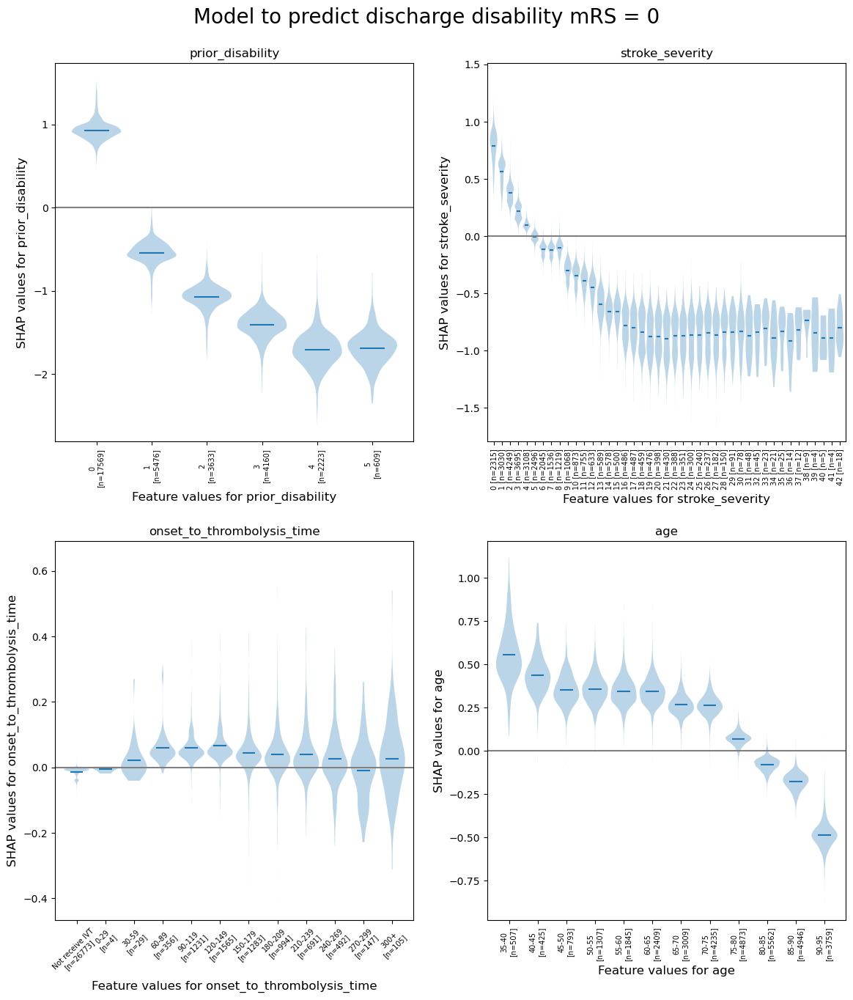

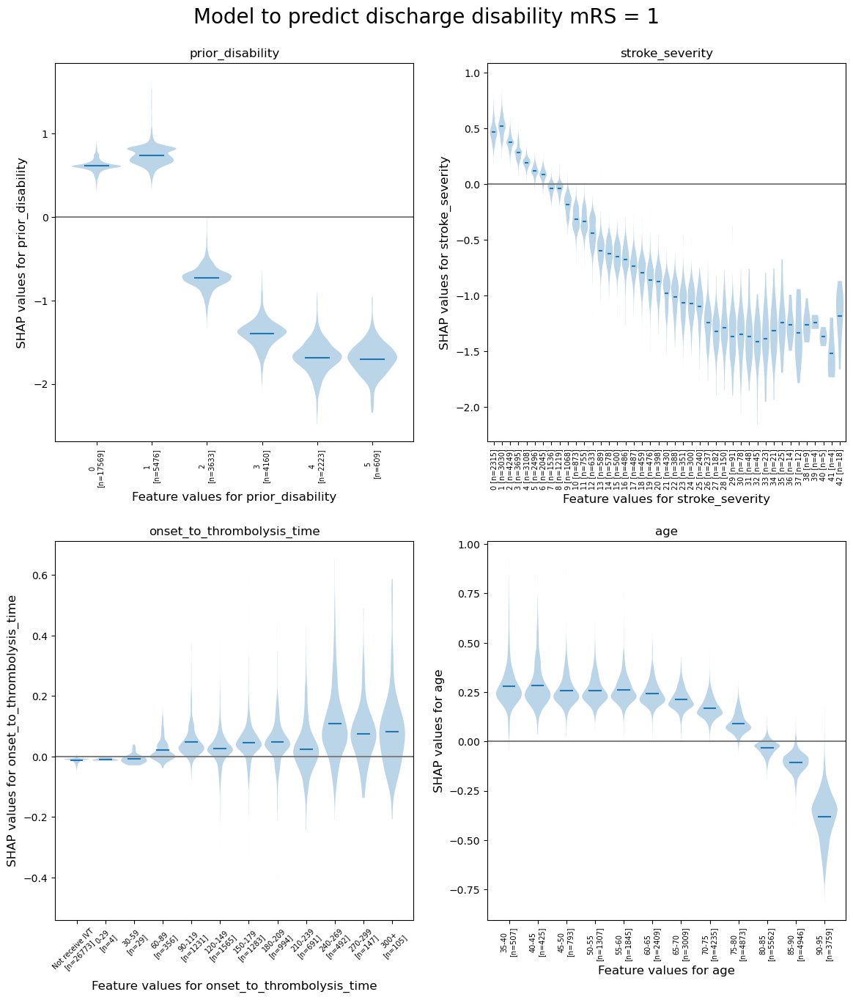

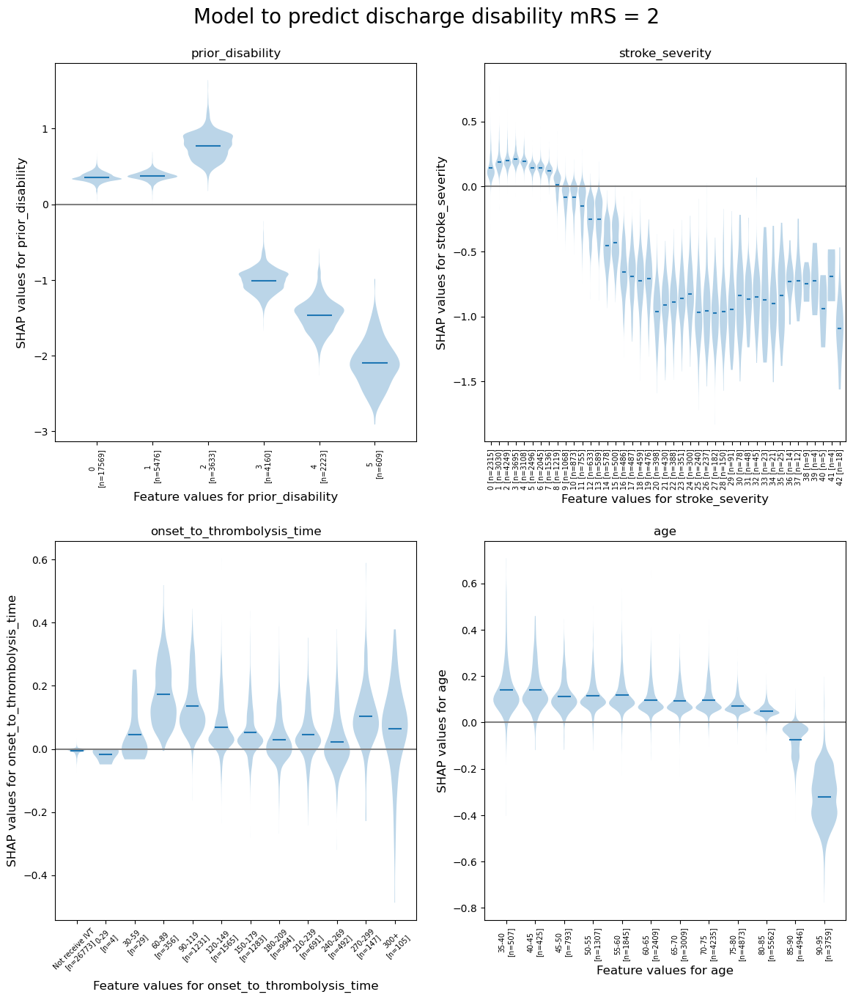

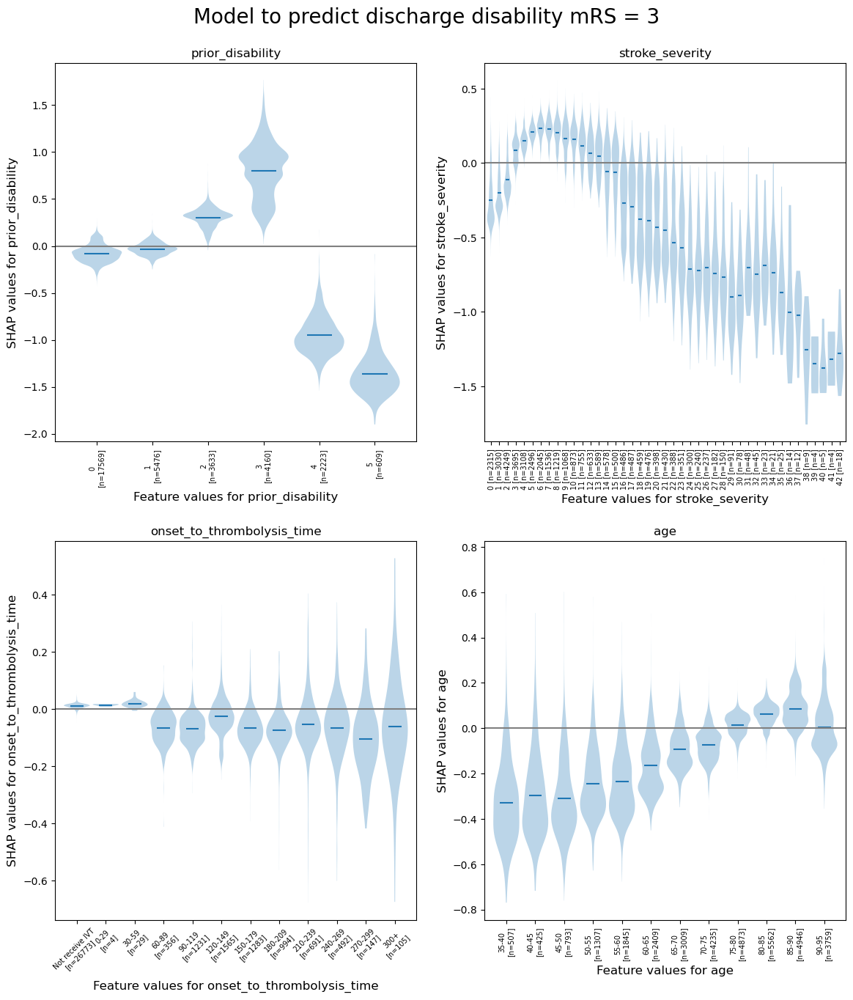

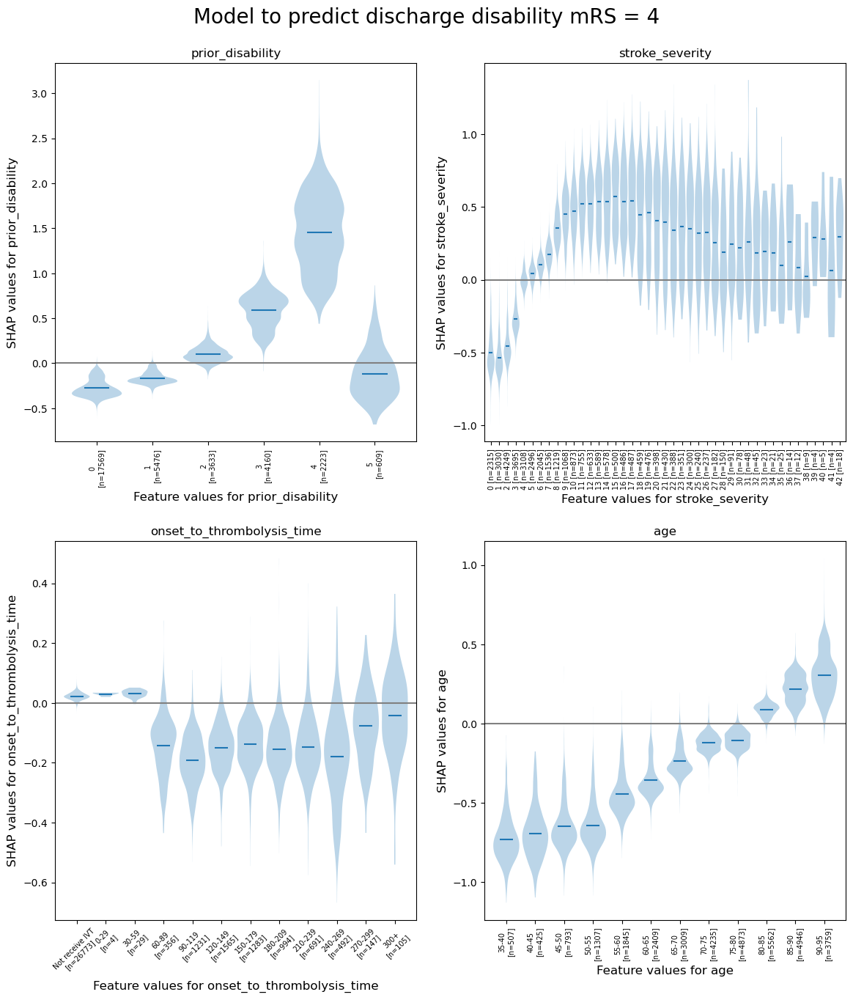

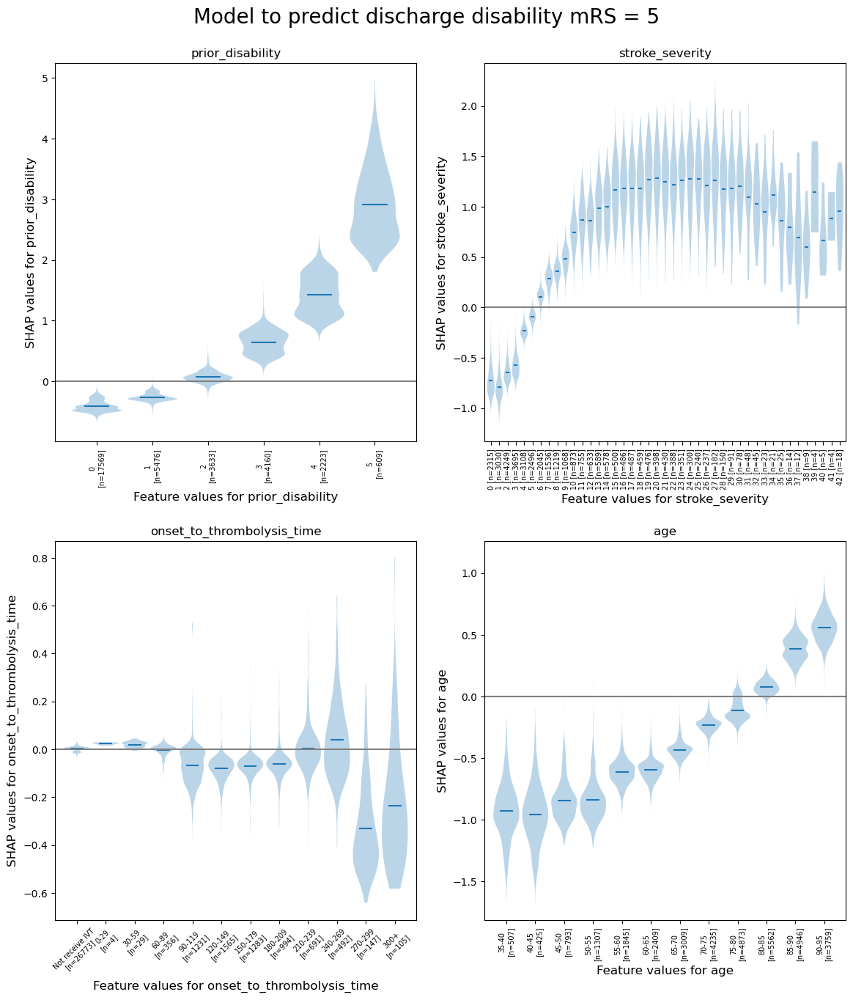

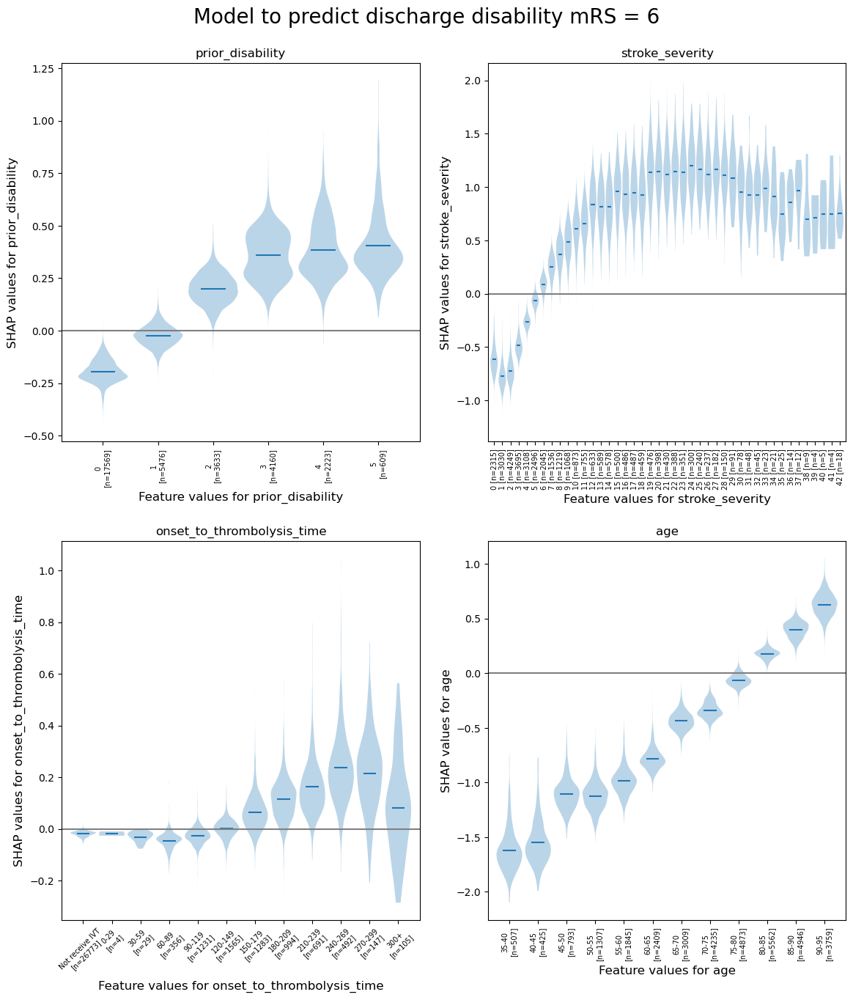

In [56]:
k = 0
shap_values_extended = shap_values_extended_kfold[k]

# Features to include in the violin plot grid
features_violin = ['prior_disability','stroke_severity',
                   'onset_to_thrombolysis_time','age']

for c in range(n_classes):
    create_grid_of_violin_plots(features_violin, 
                                c,
                                shap_values_extended
                                )

Compare SHAP values for the hospital one-hot encoded features The hospital feature is one-hot encoded, so there is a SHAP value per stroke team. We will use this to create a histogram of the frequency of the SHAP value for the hospital feature (take the mean of the SHAP values for the instances for each hospital's own patients).

In [57]:
def create_histogram_data_and_plot(test_stroke_team,
                                   shap_values,
                                   features_ohe,
                                   class_category):

    # Set up list for storing patient data and hospital SHAP
    feature_data_with_shap = []

    # Get mean SHAP for stroke team when patient attending that stroke team
    unique_stroketeams_list = list(np.unique(test_stroke_team))
    stroke_team_mean_shap = []
    stroke_team_std_shap = []
    # Loop through stroke teams
    for stroke_team in unique_stroketeams_list:
        # Identify rows in test data that match each stroke team
        mask = test_stroke_team == stroke_team
        # Extract those rows, for the class
        stroke_team_shap_all_features = shap_values[mask,:]#shap_values[mask]
        # Get column index for stroke_team_in_shap
        feature_name = 'team_' + stroke_team
        index = features_ohe.index(feature_name)
        # Get SHAP values for hospital
        stroke_team_shap = stroke_team_shap_all_features[:, index]
        # Get mean of the absolute SHAPs
        mean_shap = np.mean(np.absolute(stroke_team_shap))
        # Store mean
        stroke_team_mean_shap.append(mean_shap)
        # Get std
        std_shap = np.std(stroke_team_shap)
        # Store std
        stroke_team_std_shap.append(std_shap)

        # Get and store feature data and add SHAP
        feature_data = pd.DataFrame(data=test_stroke_team[mask].values, 
                                    columns=["Hospital_name"])
        feature_data['Hospital_SHAP'] = stroke_team_shap
        feature_data_with_shap.append(feature_data)

    # Concatenate and save feature_data_with_shap
    feature_data_with_shap = pd.concat(feature_data_with_shap, axis=0)

    filename = os.path.join(paths.data_save_path, (paths.notebook + 
                            paths.model_text + 
                            f'_individual_data_of_hospital_attended_shap_for_'
                            f'mRS{class_category}.csv'))
    feature_data_with_shap.to_csv(filename, index=False)

    # Create and save shap mean value per hospital
    hospital_data = pd.DataFrame()
    hospital_data["stroke_team"] = unique_stroketeams_list
    hospital_data["mean_abs_shap"] = stroke_team_mean_shap
    hospital_data["std_shap"] = stroke_team_std_shap
    filename = os.path.join(paths.data_save_path, (paths.notebook + 
                            paths.model_text + 
                            f'_meanabs_std_shap_per_hospital_for_mRS{class_category}'
                            f'.csv'))
    hospital_data.to_csv(filename, index=False)

    # Plot histogram of the frequency of the mean SHAP value for the instances for each hospital's own patients
    # Use from violin plots
    # facecolor = [0.12156863, 0.46666667, 0.70588235, 0.3]
    # edgecolor= [0.12156863, 0.46666667, 0.70588235, 1.]
    fig = plt.figure(figsize=(12,3))
    ax = fig.add_subplot()

    ax.hist(stroke_team_mean_shap, bins=np.arange(-1.5, 1.5, 0.1), 
            color=[0.12156863, 0.46666667, 0.70588235, 0.3], 
            ec=[0.12156863, 0.46666667, 0.70588235, 1.], 
            linewidth=1.4)
    ax.set_title(f"Outcome for class {class_category}")
    ax.set_xlabel('SHAP values (mean of the absolutes) for hospital attended')
    ax.set_ylabel('Count')
    filename = os.path.join(paths.image_save_path, (paths.notebook + 
                            paths.model_text + 
                            '_hosp_shap_hist.jpg'))
        
    plt.savefig(filename, dpi=300, 
                bbox_inches='tight', pad_inches=0.2)
    plt.show()

    return()

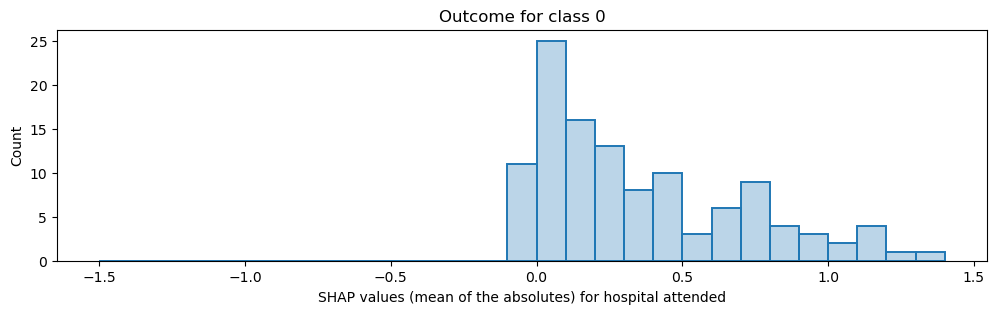

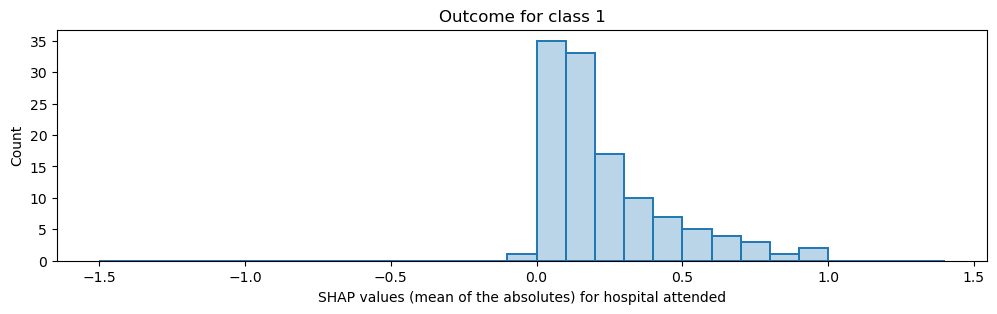

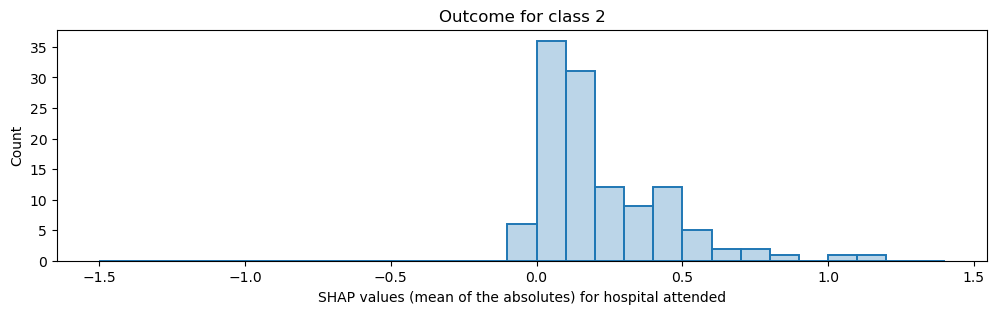

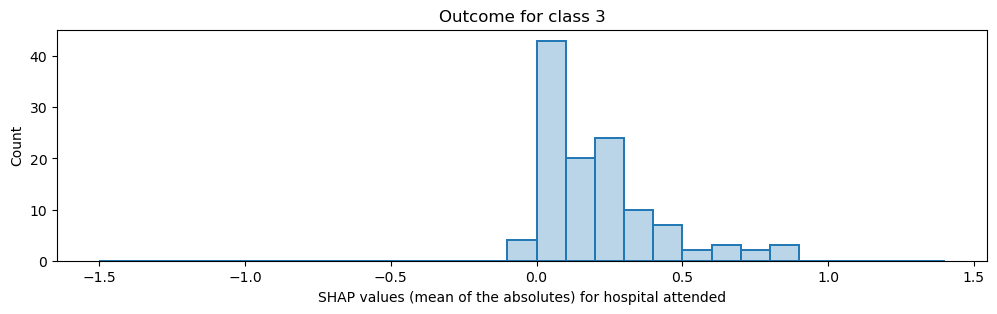

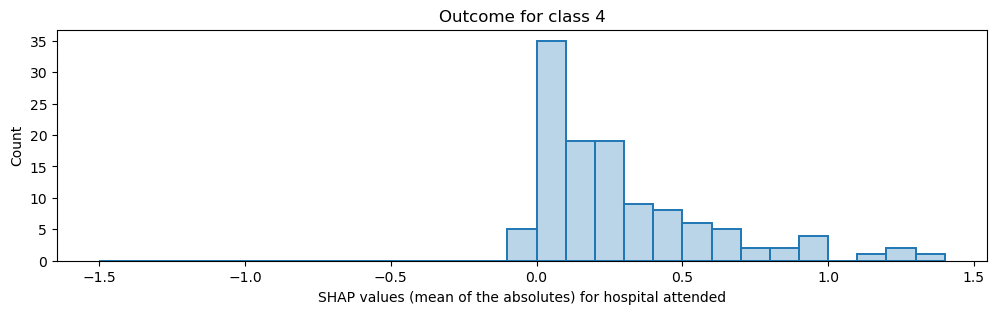

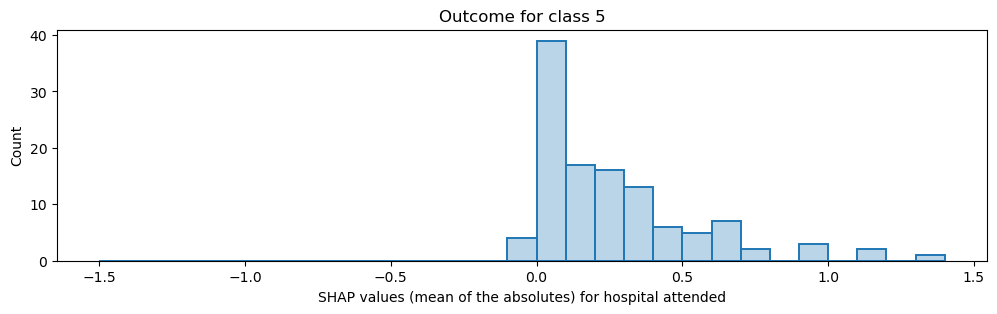

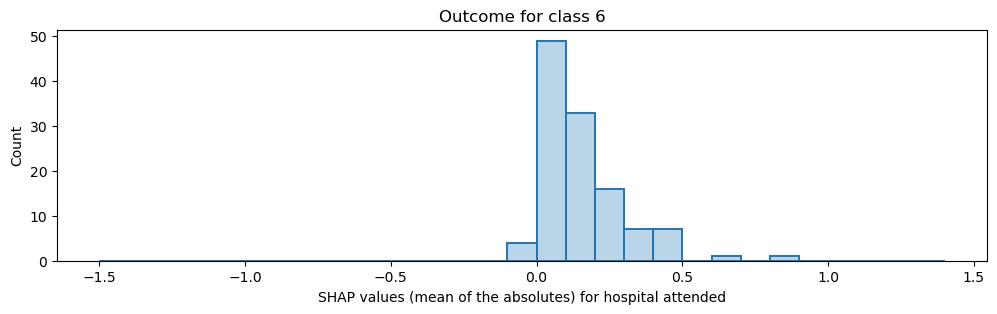

In [58]:
k = 0
test_stroke_team = test_stroke_team_kfold[k]
shap_values = shap_values_kfold[k]

for c in range(n_classes):
    create_histogram_data_and_plot(test_stroke_team,
                                   shap_values[:,:,c],
                                   feature_names_ohe,
                                   c)

For use in other notebooks, which hospital has a SHAP value that is closest to zero for all of the output classes, for this kfold?

None of the hospitals has a zero SHAP in each of the classes.

In [59]:
list_hospital_zero_mean_std = []
for c in range(n_classes):

    filename = os.path.join(paths.data_save_path, (paths.notebook + 
                            paths.model_text + 
                            f'_meanabs_std_shap_per_hospital_for_mRS{c}'
                            f'.csv'))
    
    hospital_data = pd.read_csv(filename)

    filtered_values = np.where((hospital_data["mean_abs_shap"]==0) & (hospital_data["std_shap"]==0))
    list_hospital_zero_mean_std.append(list(hospital_data["stroke_team"].loc[filtered_values].values))

list_hospital_zero_mean_std

[['Bronglais Hospital',
  'Countess of Chester Hospital',
  'Furness General Hospital',
  'Hereford County Hospital',
  'Norfolk and Norwich University Hospital',
  'Prince Charles Hospital',
  "Queen's Medical Centre - Nottingham",
  "St Mary's Hospital Newport",
  'St Richards Hospital',
  'University Hospitals Dorset Stroke Service',
  'Weston General Hospital'],
 ['Bradford and Airedale SU'],
 ['Broomfield Hospital',
  'James Paget Hospital',
  "Queen's Medical Centre - Nottingham",
  'Royal United Hospital Bath',
  "St Mary's Hospital Newport",
  'University Hospitals Bristol Inpatient Team'],
 ['Luton and Dunstable Hospital',
  'Royal Lancaster Infirmary',
  'Southend Hospital',
  'University Hospitals Dorset Stroke Service'],
 ['Doncaster Royal Infirmary',
  'Furness General Hospital',
  'Prince Philip Hospital',
  'Princess Of Wales Hospital',
  'St Richards Hospital'],
 ['Norfolk and Norwich University Hospital',
  "Queen's Medical Centre - Nottingham",
  'Withybush General Ho

In [60]:
from collections import Counter
flatten = [item for row in list_hospital_zero_mean_std for item in row]
Counter(flatten).most_common(20)

[("Queen's Medical Centre - Nottingham", 3),
 ('Furness General Hospital', 2),
 ('Norfolk and Norwich University Hospital', 2),
 ("St Mary's Hospital Newport", 2),
 ('St Richards Hospital', 2),
 ('University Hospitals Dorset Stroke Service', 2),
 ('Bronglais Hospital', 1),
 ('Countess of Chester Hospital', 1),
 ('Hereford County Hospital', 1),
 ('Prince Charles Hospital', 1),
 ('Weston General Hospital', 1),
 ('Bradford and Airedale SU', 1),
 ('Broomfield Hospital', 1),
 ('James Paget Hospital', 1),
 ('Royal United Hospital Bath', 1),
 ('University Hospitals Bristol Inpatient Team', 1),
 ('Luton and Dunstable Hospital', 1),
 ('Royal Lancaster Infirmary', 1),
 ('Southend Hospital', 1),
 ('Doncaster Royal Infirmary', 1)]

Take the mean of the SHAPS for each hospital, per class.
Then return the hospitals ranked with the smallest mean of the SHAP means (across the classes).

In [61]:
hospital_shap_mean_all_classes=pd.DataFrame()
hospital_shap_std_all_classes=pd.DataFrame()
for c in range(n_classes):

    filename = os.path.join(paths.data_save_path, (paths.notebook + 
                            paths.model_text + 
                            f'_meanabs_std_shap_per_hospital_for_mRS{c}'
                            f'.csv'))
    
    hospital_data = pd.read_csv(filename)

    hospital_shap_mean_all_classes[f"mean_abs_shap_class{c}"] = hospital_data["mean_abs_shap"]
    hospital_shap_std_all_classes[f"std_shap_class{c}"] = hospital_data["std_shap"]
hospital_shap_mean_all_classes.set_index(hospital_data["stroke_team"].values, inplace=True)
hospital_shap_std_all_classes.set_index(hospital_data["stroke_team"].values, inplace=True)

df_results = pd.DataFrame()
df_results["max_of_the_absolute_mean_shap"] = np.absolute(hospital_shap_mean_all_classes).max(axis=1)
df_results.set_index(hospital_shap_std_all_classes.index, inplace=True)
df_results.sort_values(by=["max_of_the_absolute_mean_shap"], key=abs, inplace=True)
df_results

,max_of_the_absolute_mean_shap
Royal Lancaster Infirmary,0.136118
St Richards Hospital,0.159492
Stepping Hill Hospital,0.160162
Wycombe General Hospital,0.197811
Norfolk and Norwich University Hospital,0.197916
...,...
Royal Stoke University Hospital,1.441757
Royal London Hospital HASU,1.527460
Sandwell District Hospital,1.566673
Princess Royal University Hospital HASU,1.728447


In [62]:
hospital_shap_mean_all_classes.loc["Royal Lancaster Infirmary"]

mean_abs_shap_class0    0.031250
mean_abs_shap_class1    0.136118
mean_abs_shap_class2    0.047157
mean_abs_shap_class3    0.000000
mean_abs_shap_class4    0.035217
mean_abs_shap_class5    0.067202
mean_abs_shap_class6    0.016733
Name: Royal Lancaster Infirmary, dtype: float64

# EXTRA CODE 
YET TO INCLUDE AS THINK IT'S TRYING TO WORK OUT SUBPLOTS FOR SUMMARY_PLOT (WHICH SEEMS TO NOT BE POSSIBLE)

Trying to put shap.summary_plot in a subplot. But is does not take argument ax
https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.subplots.html

Resources, trying to use subplots for SHAP plots

https://towardsdatascience.com/explainable-ai-xai-with-shap-multi-class-classification-problem-64dd30f97cea

https://github.com/Iditc/Posts-on-Medium/blob/main/Explainable%20AI/Explainable%20AI%20(XAI)%20with%20SHAP_MultiClass%20Classification%20Problem.ipynb

https://github.com/slundberg/shap/issues/367

Tricky to show as an average over the kfolds (representing the 5 plots in one as average) as the plot is using the SHAP and feature value. Can an average of both be taken?

Show the relationship between feature value and SHAP value for the top 6 influential features
(as SHAP plots scatter)

Unfortunately, that code when used for a multiclass classification model, creates beeswarm plots. Does not create the scatter plots as seen in notebook 03 (for shap paper 1)

from https://github.com/samuel-book/samuel_shap_paper_1/blob/main/xgb_10_features/03_xgb_combined_shap_key_features.ipynb

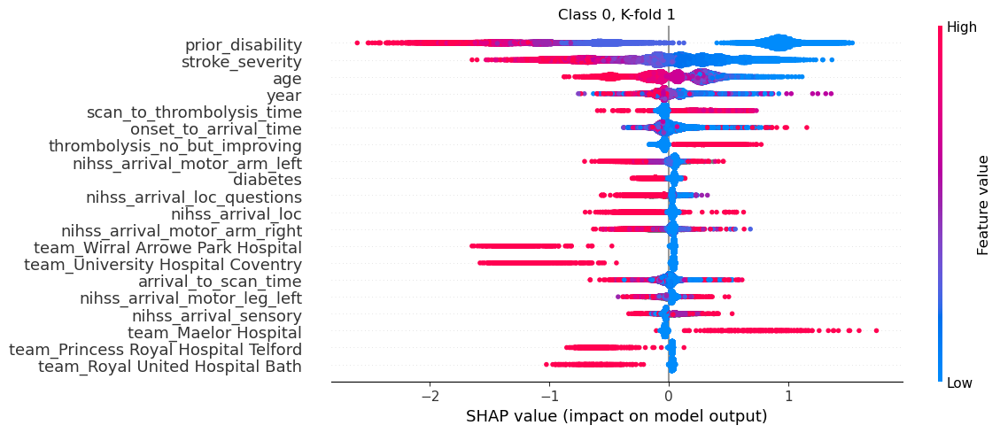

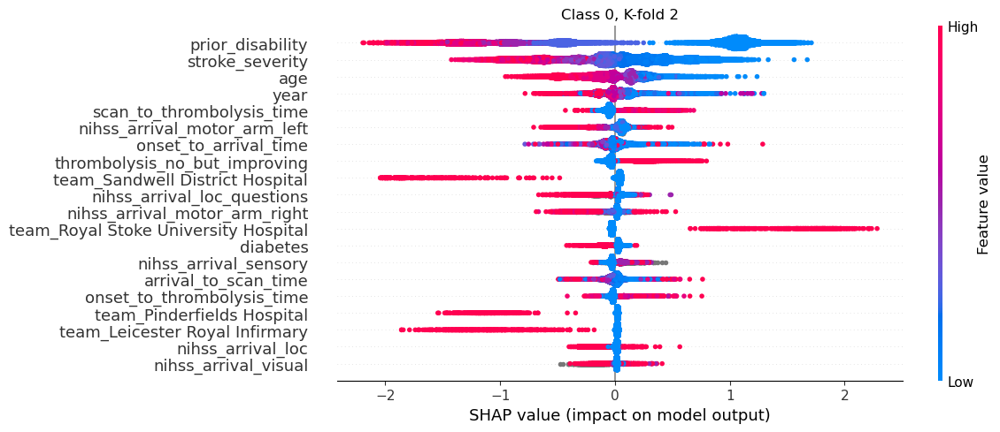

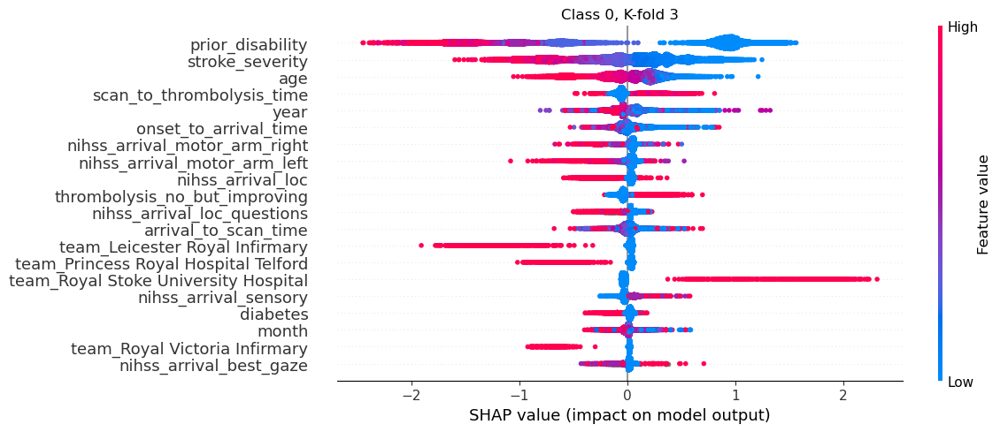

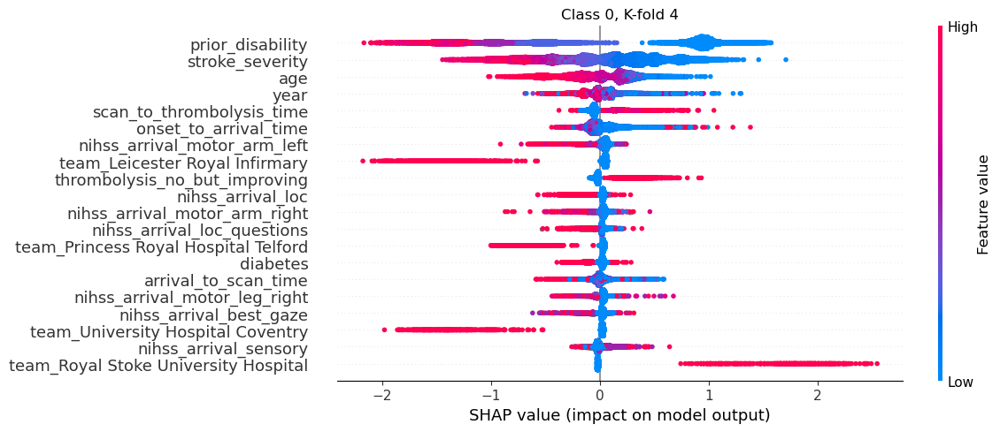

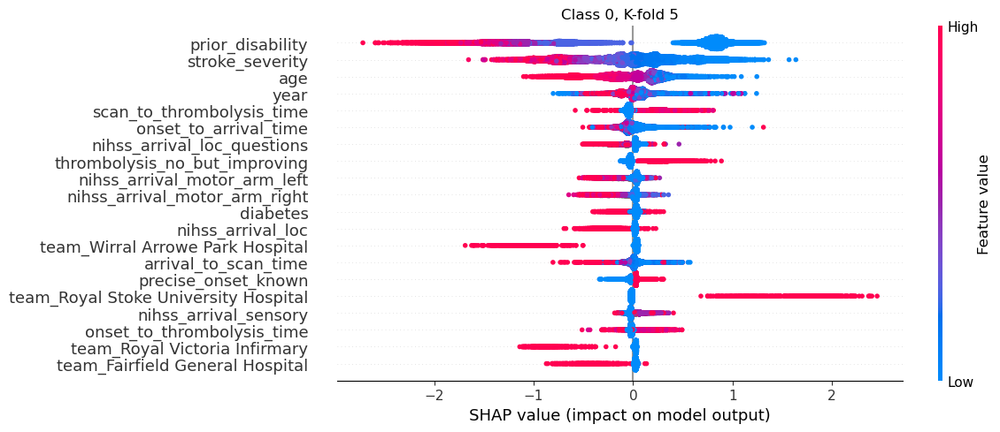

...

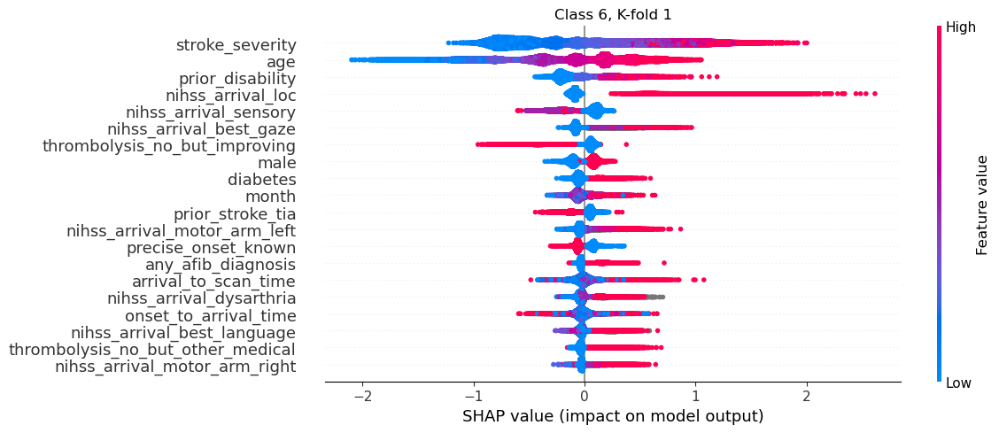

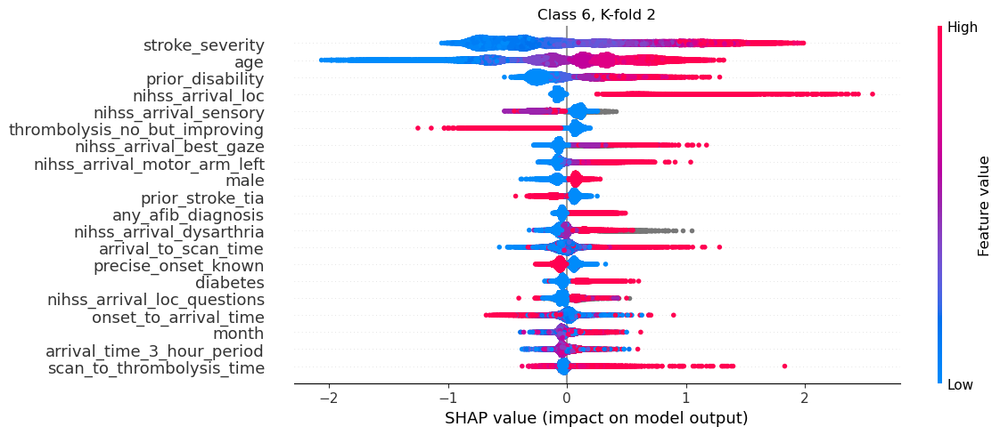

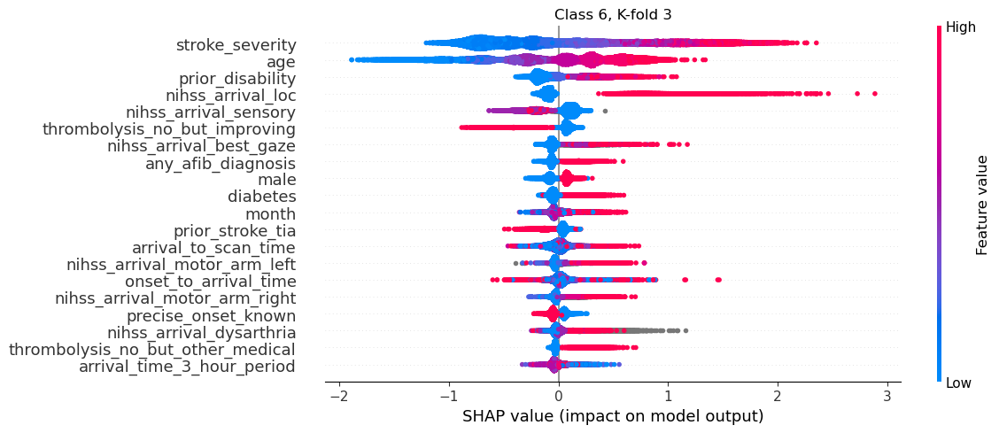

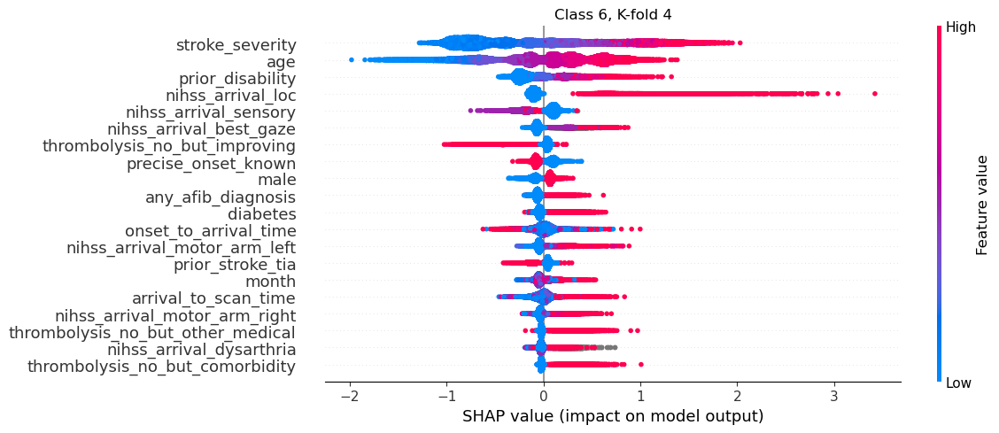

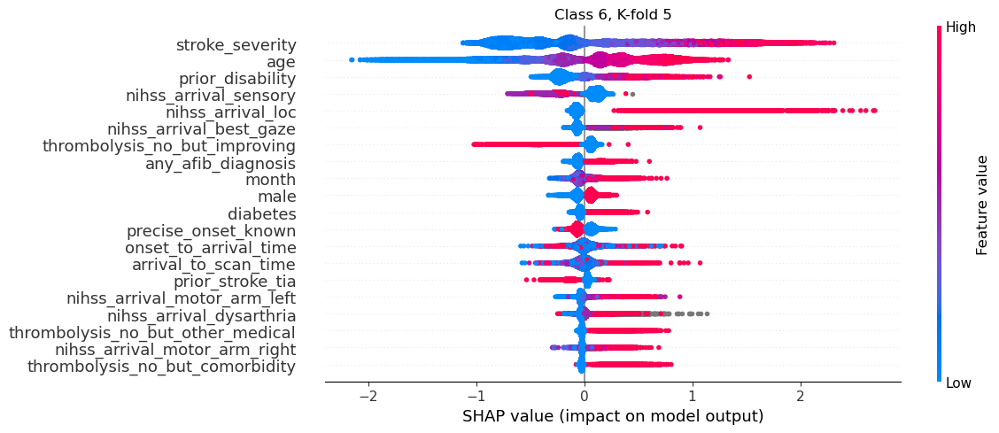

Exception: The passed Explanation object has multiple columns, please pass a single feature column to shap.plots.dependence like: shap_values[:,column]

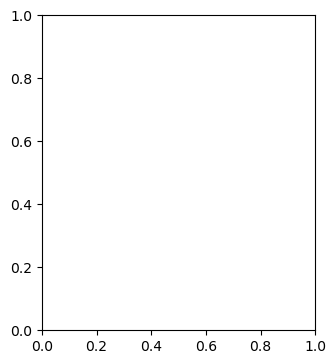

In [63]:
# Create a ranked or of the features based on the mean of the absolute SHAP values


for c in range(len(class_names)):
    for k in range(5):
        # Get k fold split
        (X_train, X_test, y_train, y_test) = get_x_y_data(train_data_kfold[k],
                                                        test_data_kfold[k],
                                                        'discharge_disability')

        shap.summary_plot(shap_values_kfold[k][:,:,c], X_test.values, 
                        feature_names=X_test.columns, show=False, 
                        plot_size=(12,5))

        plt.title(f"Class {c}, K-fold {k+1}")
        plt.tight_layout()
        plt.show()



# Initialise empty list
shap_values_mean_kfold = []

for c in range(len(class_names)):
    # For each k-fold split
    for k in range(5):
        # Calculate mean SHAP value for each feature (across all instances)
        shap_values = shap_values_kfold[k][:,:,c]
        df = pd.DataFrame(index=feature_names_ohe)
        df['mean_shap'] = np.mean(shap_values, axis=0)
        df['abs_mean_shap'] = np.abs(df['mean_shap'])
        df['mean_abs_shap'] = np.mean(np.abs(shap_values), axis=0)
        df['rank'] = df['mean_abs_shap'].rank(
            ascending=False).values
        df.sort_index()
        shap_values_mean_kfold.append(df)

    # Initialise DataFrame (stores mean of the absolute SHAP values for each kfold)
    df_mean_abs_shap = pd.DataFrame()

    # For each k-fold split
    for k in range(5):
        # mean of the absolute SHAP values for each k-fold split
        df_mean_abs_shap[f'{k}'] = shap_values_mean_kfold[k]['mean_abs_shap']
        
    #Create a dataframe that stores the min, median, and max SHAP values for each feature across the 5 k-fold splits

    df_mean_abs_shap_summary = pd.DataFrame()
    df_mean_abs_shap_summary['min'] = df_mean_abs_shap.min(axis=1)
    df_mean_abs_shap_summary['median'] = df_mean_abs_shap.median(axis=1) 
    df_mean_abs_shap_summary['max'] = df_mean_abs_shap.max(axis=1)
    df_mean_abs_shap_summary.sort_values('median', inplace=True, ascending=False)

    df_mean_abs_shap_summary

    features_ranked_by_shap = list(df_mean_abs_shap_summary.head(10).index)

    feat_to_show = features_ranked_by_shap[0:6]

    shap_values_extended = shap_values_extended_kfold[k]

    fig = plt.figure(figsize=(12,9))
    for n, feat in enumerate(feat_to_show):    
        ax = fig.add_subplot(2,3,n+1)
        shap.plots.scatter(shap_values_extended[:, feat], x_jitter=0, ax=ax, 
                           show=False)
        
        # Add line at Shap = 0
        feature_values = shap_values_extended[:, feat].data
        ax.plot([ax.get_xlim()[0], ax.get_xlim()[1]], [0,0], c='0.5')    
        
        ax.set_ylabel(f'SHAP value (log odds) for\n{feat}')
        ax.set_title(feat)
        
        # Censor arrival to scan to 1200 minutes
        if feat == 'Arrival-to-scan time':
            ax.set_xlim(0,1200)
        
    plt.tight_layout(pad=2)

    filename = os.path.join(paths.image_save_path, (paths.notebook + 
                                paths.model_text + 
                                '_thrombolysis_shap_scatter.jpg'))

    fig.savefig(filename, dpi=300, bbox_inches='tight', pad_inches=0.2)

plt.show()

Other resources: https://towardsdatascience.com/how-to-easily-customize-shap-plots-in-python-fdff9c0483f2

# EXTRA CELLS

Started to look at difference background data makes

In [ ]:
k = 0

# Calculate SHAP values
# Get k fold split
train = train_data_kfold[k]
test = test_data_kfold[k]

# Get X and y
X_train = train.drop('discharge_disability', axis=1)
X_test = test.drop('discharge_disability', axis=1)
y_train = train['discharge_disability']
y_test = test['discharge_disability']

# WHAT'S THE DIFFERENCE BETWEEN:

# 1

# Set up explainer using the model and feature values from training set
explainer = shap.TreeExplainer(model_kfold[k])#, X_train)
shap_values = explainer.shap_values(X_test)

# 2
# Set up explainer using the model and feature values from training set
explainer = shap.TreeExplainer(model_kfold[k], X_train)
# Get (and store) Shapley values along with base and feature values
shap_values_extended = explainer(X_test)
# Shap values exist for each classification in a Tree
shap_values = shap_values_extended.values

shap.summary_plot(shap_values, X_test.values, plot_type="bar", 
                  class_names= class_names, feature_names = X_test.columns)